In [180]:
import pandas as pd
import numpy as np
pd.set_option('display.max_columns', None)
import warnings
warnings.filterwarnings('ignore')
import matplotlib.pyplot as plt
import seaborn as sns 
%matplotlib inline
import math
from sklearn.preprocessing import Normalizer, StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.preprocessing import OneHotEncoder
from scipy import stats

In [181]:
data = pd.read_csv('/Users/sarahrestrepo/Desktop/fifa21_male2.csv')

In [182]:
data.head()

,ID,Name,Age,OVA,Nationality,Club,BOV,BP,Position,Player Photo,Club Logo,Flag Photo,POT,Team & Contract,Height,Weight,foot,Growth,Joined,Loan Date End,Value,Wage,Release Clause,Contract,Attacking,Crossing,Finishing,Heading Accuracy,Short Passing,Volleys,Skill,Dribbling,Curve,FK Accuracy,Long Passing,Ball Control,Movement,Acceleration,Sprint Speed,Agility,Reactions,Balance,Power,Shot Power,Jumping,Stamina,Strength,Long Shots,Mentality,Aggression,Interceptions,Positioning,Vision,Penalties,Composure,Defending,Marking,Standing Tackle,Sliding Tackle,Goalkeeping,GK Diving,GK Handling,GK Kicking,GK Positioning,GK Reflexes,Total Stats,Base Stats,W/F,SM,A/W,D/W,IR,PAC,SHO,PAS,DRI,DEF,PHY,Hits,LS,ST,RS,LW,LF,CF,RF,RW,LAM,CAM,RAM,LM,LCM,CM,RCM,RM,LWB,LDM,CDM,RDM,RWB,LB,LCB,CB,RCB,RB,GK,Gender
0,2,G. Pasquale,33,69,Italy,Udinese,71,LWB,LM,https://cdn.sofifa.com/players/000/002/16_120.png,https://cdn.sofifa.com/teams/55/light_60.png,https://cdn.sofifa.com/flags/it.png,69,Udinese 2008 ~ 2016,"6'0""",181lbs,Left,0,1-Jul-08,NaN,€625K,€7K,€0,2008 ~ 2016,313,75,50,59,71,58.0,338,73,65.0,60,69,71,347,68,74,68.0,69,68.0,347,74,68.0,69,68,68,320,72,69.0,63.0,66.0,50,NaN,208,70,69,69.0,56,14,5,15,10,12,1929,408,3 ★,2★,Medium,High,2 ★,71,59,70,71,68,69,4,65+0,65+0,65+0,68+0,67+0,67+0,67+0,68+0,68+0,68+0,68+0,69+0,69+0,69+0,69+0,69+0,71+-2,70+-1,70+-1,70+-1,71+-2,70+-1,69+0,69+0,69+0,70+-1,17+0,Male
1,16,Luis García,37,71,Spain,KAS Eupen,70,CM,CM CAM CDM,https://cdn.sofifa.com/players/000/016/19_120.png,https://cdn.sofifa.com/teams/2013/light_60.png,https://cdn.sofifa.com/flags/es.png,71,KAS Eupen 2014 ~ 2019,"5'10""",143lbs,Right,0,19-Jul-14,NaN,€600K,€7K,€1.1M,2014 ~ 2019,337,68,64,61,76,68.0,369,69,79.0,79,71,71,305,56,50,62.0,65,72.0,324,75,54.0,64,60,71,362,71,71.0,72.0,73.0,75,79.0,153,70,43,40.0,56,9,12,13,11,11,1906,385,4 ★,3★,Medium,Medium,1 ★,53,69,73,69,58,63,4,67+1,67+1,67+1,67+0,68+0,68+0,68+0,67+0,70+1,70+1,70+1,68+1,70+1,70+1,70+1,68+1,62+1,66+1,66+1,66+1,62+1,60+1,60+1,60+1,60+1,60+1,17+1,Male
2,27,J. Cole,33,71,England,Coventry City,71,CAM,CAM RM RW LM,https://cdn.sofifa.com/players/000/027/16_120.png,https://cdn.sofifa.com/teams/1800/light_60.png,https://cdn.sofifa.com/flags/gb-eng.png,71,Coventry City 2016 ~ 2020,"5'9""",161lbs,Right,0,7-Jan-16,NaN,€1.1M,€15K,€0,2016 ~ 2020,337,80,64,41,77,75.0,387,79,84.0,77,69,78,295,48,42,71.0,59,75.0,284,72,58.0,29,56,69,317,69,39.0,69.0,74.0,66,NaN,99,35,34,30.0,51,9,6,13,16,7,1770,354,4 ★,4★,Medium,Low,2 ★,45,68,76,77,36,52,11,64+0,64+0,64+0,70+0,69+0,69+0,69+0,70+0,71+0,71+0,71+0,68+0,66+0,66+0,66+0,68+0,52+0,54+0,54+0,54+0,52+0,47+0,46+0,46+0,46+0,47+0,15+0,Male
3,36,D. Yorke,36,68,Trinidad &amp; Tobago,Sunderland,70,ST,NaN,https://cdn.sofifa.com/players/000/036/09_120.png,https://cdn.sofifa.com/teams/106/light_60.png,https://cdn.sofifa.com/flags/tt.png,82,Sunderland 2009,"5'11""",165lbs,Right,14,NaN,NaN,€0,€0,€0,2009,264,54,70,60,80,NaN,255,68,NaN,46,64,77,176,59,62,NaN,55,NaN,239,63,NaN,51,66,59,271,59,70.0,72.0,NaN,70,NaN,75,34,41,NaN,68,5,21,64,21,21,1348,369,3 ★,1★,NaN,NaN,1 ★,61,66,66,69,47,60,3,67+0,67+0,67+0,66+0,67+0,67+0,67+0,66+0,70+0,70+0,70+0,66+0,68+0,68+0,68+0,66+0,56+0,65+0,65+0,65+0,56+0,57+0,51+0,51+0,51+0,57+0,22+0,Male
4,41,Iniesta,36,81,Spain,Vissel Kobe,82,CAM,CM CAM,https://cdn.sofifa.com/players/000/041/20_120.png,https://cdn.sofifa.com/teams/101146/light_60.png,https://cdn.sofifa.com/flags/es.png,81,Vissel Kobe 2018 ~ 2021,"5'7""",150lbs,Right,0,16-Jul-18,NaN,€5.5M,€12K,€7.2M,2018 ~ 2021,367,75,69,54,90,79.0,408,85,80.0,70,83,90,346,61,56,79.0,75,75.0,297,67,40.0,58,62,70,370,58,70.0,78.0,93.0,71,89.0,181,68,57,56.0,45,6,13,6,13,7,2014,420,4 ★,4★,High,Medium,4 ★,58,70,85,85,63,59,149,72+3,72+3,72+3,79+0,79+0,79+0,79+0,79+0,82+-1,82+-1,82+-1,79+2,81+0,81+0,81+0,79+2,70+3,73+3,73+3,73+3,70+3,67+3,64+3,64+3,64+3,67+3,17+3,Male


In [183]:
data.shape

(17125, 107)

In [184]:
#df1 specific columns chosen
df1 = data[['Name', 'Age','OVA','Club','Position','POT','Height','Weight','foot','Value','Wage','Attacking','Crossing','Finishing','Heading Accuracy','Short Passing','Volleys','Skill','Dribbling','Curve','FK Accuracy','Long Passing','Ball Control','Skill','Movement','Acceleration','Sprint Speed','Agility','Reactions','Balance','Power','Shot Power','Jumping','Stamina','Strength','Long Shots','Mentality','Aggression','Interceptions','Positioning','Vision','Penalties','Composure','Defending','Marking','Standing Tackle','Sliding Tackle','Goalkeeping','GK Diving','GK Handling','GK Kicking','GK Positioning','GK Reflexes','Total Stats','Gender','PAC','SHO','PAS','DRI','DEF','PHY','Hits']]

In [185]:
df1.head()

,Name,Age,OVA,Club,Position,POT,Height,Weight,foot,Value,Wage,Attacking,Crossing,Finishing,Heading Accuracy,Short Passing,Volleys,Skill,Dribbling,Curve,FK Accuracy,Long Passing,Ball Control,Skill,Movement,Acceleration,Sprint Speed,Agility,Reactions,Balance,Power,Shot Power,Jumping,Stamina,Strength,Long Shots,Mentality,Aggression,Interceptions,Positioning,Vision,Penalties,Composure,Defending,Marking,Standing Tackle,Sliding Tackle,Goalkeeping,GK Diving,GK Handling,GK Kicking,GK Positioning,GK Reflexes,Total Stats,Gender,PAC,SHO,PAS,DRI,DEF,PHY,Hits
0,G. Pasquale,33,69,Udinese,LM,69,"6'0""",181lbs,Left,€625K,€7K,313,75,50,59,71,58.0,338,73,65.0,60,69,71,338,347,68,74,68.0,69,68.0,347,74,68.0,69,68,68,320,72,69.0,63.0,66.0,50,NaN,208,70,69,69.0,56,14,5,15,10,12,1929,Male,71,59,70,71,68,69,4
1,Luis García,37,71,KAS Eupen,CM CAM CDM,71,"5'10""",143lbs,Right,€600K,€7K,337,68,64,61,76,68.0,369,69,79.0,79,71,71,369,305,56,50,62.0,65,72.0,324,75,54.0,64,60,71,362,71,71.0,72.0,73.0,75,79.0,153,70,43,40.0,56,9,12,13,11,11,1906,Male,53,69,73,69,58,63,4
2,J. Cole,33,71,Coventry City,CAM RM RW LM,71,"5'9""",161lbs,Right,€1.1M,€15K,337,80,64,41,77,75.0,387,79,84.0,77,69,78,387,295,48,42,71.0,59,75.0,284,72,58.0,29,56,69,317,69,39.0,69.0,74.0,66,NaN,99,35,34,30.0,51,9,6,13,16,7,1770,Male,45,68,76,77,36,52,11
3,D. Yorke,36,68,Sunderland,NaN,82,"5'11""",165lbs,Right,€0,€0,264,54,70,60,80,NaN,255,68,NaN,46,64,77,255,176,59,62,NaN,55,NaN,239,63,NaN,51,66,59,271,59,70.0,72.0,NaN,70,NaN,75,34,41,NaN,68,5,21,64,21,21,1348,Male,61,66,66,69,47,60,3
4,Iniesta,36,81,Vissel Kobe,CM CAM,81,"5'7""",150lbs,Right,€5.5M,€12K,367,75,69,54,90,79.0,408,85,80.0,70,83,90,408,346,61,56,79.0,75,75.0,297,67,40.0,58,62,70,370,58,70.0,78.0,93.0,71,89.0,181,68,57,56.0,45,6,13,6,13,7,2014,Male,58,70,85,85,63,59,149


In [186]:
df1.columns = [item.lower().replace(' ', '_')   for item in df1.columns]

In [187]:
df1.head()

,name,age,ova,club,position,pot,height,weight,foot,value,wage,attacking,crossing,finishing,heading_accuracy,short_passing,volleys,skill,dribbling,curve,fk_accuracy,long_passing,ball_control,skill,movement,acceleration,sprint_speed,agility,reactions,balance,power,shot_power,jumping,stamina,strength,long_shots,mentality,aggression,interceptions,positioning,vision,penalties,composure,defending,marking,standing_tackle,sliding_tackle,goalkeeping,gk_diving,gk_handling,gk_kicking,gk_positioning,gk_reflexes,total_stats,gender,pac,sho,pas,dri,def,phy,hits
0,G. Pasquale,33,69,Udinese,LM,69,"6'0""",181lbs,Left,€625K,€7K,313,75,50,59,71,58.0,338,73,65.0,60,69,71,338,347,68,74,68.0,69,68.0,347,74,68.0,69,68,68,320,72,69.0,63.0,66.0,50,NaN,208,70,69,69.0,56,14,5,15,10,12,1929,Male,71,59,70,71,68,69,4
1,Luis García,37,71,KAS Eupen,CM CAM CDM,71,"5'10""",143lbs,Right,€600K,€7K,337,68,64,61,76,68.0,369,69,79.0,79,71,71,369,305,56,50,62.0,65,72.0,324,75,54.0,64,60,71,362,71,71.0,72.0,73.0,75,79.0,153,70,43,40.0,56,9,12,13,11,11,1906,Male,53,69,73,69,58,63,4
2,J. Cole,33,71,Coventry City,CAM RM RW LM,71,"5'9""",161lbs,Right,€1.1M,€15K,337,80,64,41,77,75.0,387,79,84.0,77,69,78,387,295,48,42,71.0,59,75.0,284,72,58.0,29,56,69,317,69,39.0,69.0,74.0,66,NaN,99,35,34,30.0,51,9,6,13,16,7,1770,Male,45,68,76,77,36,52,11
3,D. Yorke,36,68,Sunderland,NaN,82,"5'11""",165lbs,Right,€0,€0,264,54,70,60,80,NaN,255,68,NaN,46,64,77,255,176,59,62,NaN,55,NaN,239,63,NaN,51,66,59,271,59,70.0,72.0,NaN,70,NaN,75,34,41,NaN,68,5,21,64,21,21,1348,Male,61,66,66,69,47,60,3
4,Iniesta,36,81,Vissel Kobe,CM CAM,81,"5'7""",150lbs,Right,€5.5M,€12K,367,75,69,54,90,79.0,408,85,80.0,70,83,90,408,346,61,56,79.0,75,75.0,297,67,40.0,58,62,70,370,58,70.0,78.0,93.0,71,89.0,181,68,57,56.0,45,6,13,6,13,7,2014,Male,58,70,85,85,63,59,149


In [188]:
df1.shape

(17125, 62)

In [189]:
#checking for null values
df1.isna().sum()

name          0
age           0
ova           0
club         23
position    413
           ... 
pas           0
dri           0
def           0
phy           0
hits          0
Length: 62, dtype: int64

In [190]:
df1 = df1.dropna()

In [191]:
df1.shape

(16414, 62)

In [192]:
df1.columns

Index(['name', 'age', 'ova', 'club', 'position', 'pot', 'height', 'weight',
       'foot', 'value', 'wage', 'attacking', 'crossing', 'finishing',
       'heading_accuracy', 'short_passing', 'volleys', 'skill', 'dribbling',
       'curve', 'fk_accuracy', 'long_passing', 'ball_control', 'skill',
       'movement', 'acceleration', 'sprint_speed', 'agility', 'reactions',
       'balance', 'power', 'shot_power', 'jumping', 'stamina', 'strength',
       'long_shots', 'mentality', 'aggression', 'interceptions', 'positioning',
       'vision', 'penalties', 'composure', 'defending', 'marking',
       'standing_tackle', 'sliding_tackle', 'goalkeeping', 'gk_diving',
       'gk_handling', 'gk_kicking', 'gk_positioning', 'gk_reflexes',
       'total_stats', 'gender', 'pac', 'sho', 'pas', 'dri', 'def', 'phy',
       'hits'],
      dtype='object')

In [355]:
df1 = df1.drop_duplicates()

In [194]:
#rearranging index after all dropped data
df1 = df1.reset_index(drop=True)

In [195]:
df1.head()

,name,age,ova,club,position,pot,height,weight,foot,value,wage,attacking,crossing,finishing,heading_accuracy,short_passing,volleys,skill,dribbling,curve,fk_accuracy,long_passing,ball_control,skill,movement,acceleration,sprint_speed,agility,reactions,balance,power,shot_power,jumping,stamina,strength,long_shots,mentality,aggression,interceptions,positioning,vision,penalties,composure,defending,marking,standing_tackle,sliding_tackle,goalkeeping,gk_diving,gk_handling,gk_kicking,gk_positioning,gk_reflexes,total_stats,gender,pac,sho,pas,dri,def,phy,hits
0,Luis García,37,71,KAS Eupen,CM CAM CDM,71,"5'10""",143lbs,Right,€600K,€7K,337,68,64,61,76,68.0,369,69,79.0,79,71,71,369,305,56,50,62.0,65,72.0,324,75,54.0,64,60,71,362,71,71.0,72.0,73.0,75,79.0,153,70,43,40.0,56,9,12,13,11,11,1906,Male,53,69,73,69,58,63,4
1,Iniesta,36,81,Vissel Kobe,CM CAM,81,"5'7""",150lbs,Right,€5.5M,€12K,367,75,69,54,90,79.0,408,85,80.0,70,83,90,408,346,61,56,79.0,75,75.0,297,67,40.0,58,62,70,370,58,70.0,78.0,93.0,71,89.0,181,68,57,56.0,45,6,13,6,13,7,2014,Male,58,70,85,85,63,59,149
2,E. Belözoğlu,38,77,Fenerbahçe SK,CM CDM,77,"5'7""",159lbs,Left,€2.8M,€44K,342,80,66,43,84,69.0,406,77,83.0,80,85,81,406,308,54,36,67.0,70,81.0,340,77,72.0,51,64,76,384,87,62.0,65.0,85.0,85,80.0,190,65,65,60.0,47,7,11,7,14,8,2017,Male,44,71,83,77,62,66,7
3,R. Keane,35,80,LA Galaxy,ST,80,"5'9""",161lbs,Right,€5.5M,€10K,380,68,84,63,81,84.0,374,82,82.0,63,63,84,374,380,69,68,77.0,83,83.0,363,81,62.0,72,68,80,343,67,34.0,85.0,82.0,75,86.0,71,28,26,17.0,63,11,9,13,14,16,1974,Male,68,82,75,82,31,69,10
4,G. Buffon,42,82,Juventus,GK,82,"6'4""",203lbs,Right,€2.2M,€41K,95,13,15,13,37,17.0,122,26,20.0,13,35,28,122,251,37,30,55.0,80,49.0,243,56,71.0,34,69,13,150,38,28.0,12.0,50.0,22,70.0,35,13,11,11.0,396,77,76,74,91,78,1292,Male,77,76,74,78,33,91,154


In [20]:
#checking all data types
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16414 entries, 0 to 16413
Data columns (total 62 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   name              16414 non-null  object 
 1   age               16414 non-null  int64  
 2   ova               16414 non-null  int64  
 3   club              16414 non-null  object 
 4   position          16414 non-null  object 
 5   pot               16414 non-null  int64  
 6   height            16414 non-null  object 
 7   weight            16414 non-null  object 
 8   foot              16414 non-null  object 
 9   value             16414 non-null  object 
 10  wage              16414 non-null  object 
 11  attacking         16414 non-null  int64  
 12  crossing          16414 non-null  int64  
 13  finishing         16414 non-null  int64  
 14  heading_accuracy  16414 non-null  int64  
 15  short_passing     16414 non-null  int64  
 16  volleys           16414 non-null  float6

In [196]:
best_players_OVA = df1.sort_values(['ova'],ascending=[False]).head(10)

In [197]:
#Best player OVA = Messi
best_players_OVA

,name,age,ova,club,position,pot,height,weight,foot,value,wage,attacking,crossing,finishing,heading_accuracy,short_passing,volleys,skill,dribbling,curve,fk_accuracy,long_passing,ball_control,skill,movement,acceleration,sprint_speed,agility,reactions,balance,power,shot_power,jumping,stamina,strength,long_shots,mentality,aggression,interceptions,positioning,vision,penalties,composure,defending,marking,standing_tackle,sliding_tackle,goalkeeping,gk_diving,gk_handling,gk_kicking,gk_positioning,gk_reflexes,total_stats,gender,pac,sho,pas,dri,def,phy,hits
393,L. Messi,33,93,FC Barcelona,RW ST CF,93,"5'7""",159lbs,Left,€67.5M,€560K,429,85,95,70,91,88.0,470,96,93.0,94,91,96,470,451,91,80,91.0,94,95.0,389,86,68.0,72,69,94,347,44,40.0,93.0,95.0,75,96.0,91,32,35,24.0,54,6,11,15,14,8,2231,Male,85,92,91,95,38,65,830
40,Cristiano Ronaldo,35,92,Juventus,ST LW,92,"6'2""",183lbs,Right,€46M,€220K,437,84,95,90,82,86.0,414,88,81.0,76,77,92,414,431,87,91,87.0,95,71.0,444,94,95.0,84,78,93,353,63,29.0,95.0,82.0,84,95.0,84,28,32,24.0,58,7,11,15,14,11,2221,Male,89,93,81,89,35,77,750
3037,J. Oblak,27,91,Atlético Madrid,GK,93,"6'2""",192lbs,Right,€75M,€125K,95,13,11,15,43,13.0,109,12,13.0,14,40,30,109,307,43,60,67.0,88,49.0,268,59,78.0,41,78,12,140,34,19.0,11.0,65.0,11,68.0,57,27,12,18.0,437,87,92,78,90,90,1413,Male,87,92,78,90,52,90,220
2045,Neymar Jr,28,91,Paris Saint-Germain,LW CAM,91,"5'9""",150lbs,Right,€90M,€270K,408,85,87,62,87,87.0,448,95,88.0,89,81,95,448,453,94,89,96.0,91,83.0,357,80,62.0,81,50,84,356,51,36.0,87.0,90.0,92,93.0,94,35,30,29.0,59,9,9,15,15,11,2175,Male,91,85,86,94,36,59,546
1692,R. Lewandowski,31,91,FC Bayern München,ST,91,"6'0""",176lbs,Right,€80M,€240K,423,71,94,85,84,89.0,407,85,79.0,85,70,88,407,407,77,78,77.0,93,82.0,420,89,84.0,76,86,85,391,81,49.0,94.0,79.0,88,88.0,96,35,42,19.0,51,15,6,12,8,10,2195,Male,78,91,78,85,43,82,487
2259,K. De Bruyne,29,91,Manchester City,CAM CM,91,"5'11""",154lbs,Right,€87M,€370K,407,94,82,55,94,82.0,441,88,85.0,83,93,92,441,398,77,76,78.0,91,76.0,408,91,63.0,89,74,91,408,76,66.0,88.0,94.0,84,91.0,186,68,65,53.0,56,15,13,5,10,13,2304,Male,76,86,93,88,64,78,406
5112,Alisson,27,90,Liverpool,GK,91,"6'3""",201lbs,Right,€62.5M,€160K,114,17,13,19,45,20.0,138,27,19.0,18,44,30,138,268,56,47,40.0,88,37.0,240,64,52.0,32,78,14,140,27,11.0,13.0,66.0,23,65.0,50,15,19,16.0,439,86,88,85,91,89,1389,Male,86,88,85,89,51,91,228
3527,V. van Dijk,28,90,Liverpool,CB,91,"6'4""",203lbs,Right,€75.5M,€210K,316,53,52,87,79,45.0,363,70,60.0,70,86,77,363,354,72,79,61.0,89,53.0,402,81,90.0,75,92,64,347,83,90.0,47.0,65.0,62,90.0,272,93,93,86.0,58,13,10,13,11,11,2112,Male,76,60,71,71,91,86,413
4458,M. Salah,28,90,Liverpool,RW,90,"5'9""",157lbs,Left,€78M,€250K,392,79,91,59,84,79.0,406,90,83.0,69,75,89,406,460,94,92,91.0,92,91.0,393,80,69.0,85,75,84,376,63,55.0,91.0,84.0,83,90.0,122,38,43,41.0,62,14,14,9,11,14,2211,Male,93,86,81,90,45,75,382
8632,K. Mbappé,21,90,Paris Saint-Germain,ST LW RW,95,"5'10""",161lbs,Right,€105.5M,€160K,408,78,91,73,83,83.0,394,92,79.0,63,70,90,394,458,96,96,92.0,92,82.0,404,86,77.0,86,76,79,341,62,38.0,91.0,80.0,70,84.0,100,34,34,32.0,42,13,5,7,11,6,2147,Male,96,86,78,91,39,76,1.2K


In [198]:
BP = best_players_OVA[['name','ova']]
BP.head(5)

,name,ova
393,L. Messi,93
40,Cristiano Ronaldo,92
3037,J. Oblak,91
2045,Neymar Jr,91
1692,R. Lewandowski,91


In [199]:
df1['hits'].isnull().values.any()

False

In [200]:
df1['hits']

0          4
1        149
2          7
3         10
4        154
        ... 
16409      5
16410      5
16411      3
16412      5
16413      4
Name: hits, Length: 16414, dtype: object

In [201]:
#coercing to numeric
df1['hits']=pd.to_numeric(df1['hits'],errors='coerce')

In [202]:
df1['hits'].isna().sum()

64

In [203]:
df1['hits'] = df1['hits'].fillna(np.mean(df1['hits']))

In [204]:
df1['hits'].isna().sum()

0

In [205]:
Most_goals = df1.sort_values(['hits'],ascending=[False]).head(10)

In [206]:
#Most goals = D.Kulusevski
Most_goals

,name,age,ova,club,position,pot,height,weight,foot,value,wage,attacking,crossing,finishing,heading_accuracy,short_passing,volleys,skill,dribbling,curve,fk_accuracy,long_passing,ball_control,skill,movement,acceleration,sprint_speed,agility,reactions,balance,power,shot_power,jumping,stamina,strength,long_shots,mentality,aggression,interceptions,positioning,vision,penalties,composure,defending,marking,standing_tackle,sliding_tackle,goalkeeping,gk_diving,gk_handling,gk_kicking,gk_positioning,gk_reflexes,total_stats,gender,pac,sho,pas,dri,def,phy,hits
13278,D. Kulusevski,20,77,Juventus,RW CAM,87,"6'1""",165lbs,Left,€14.5M,€54K,321,74,70,54,79,44.0,356,80,74.0,47,73,82,356,371,82,81,64.0,80,64.0,364,68,57.0,90,73,76,330,67,55.0,73.0,78.0,57,78.0,172,50,64,58.0,44,14,5,10,10,5,1958,Male,81,69,75,78,56,75,974.0
14084,K. Adeyemi,18,69,FC Red Bull Salzburg,ST LW,87,"5'10""",150lbs,Left,€2.2M,€5K,325,61,69,62,67,66.0,324,75,66.0,59,51,73,324,403,89,88,87.0,63,76.0,333,67,83.0,58,56,69,248,36,17.0,63.0,66.0,66,70.0,62,18,19,25.0,50,12,12,7,12,7,1745,Male,88,68,63,75,23,54,961.0
10628,Cucurella,21,81,Getafe CF,LM LB,89,"5'8""",146lbs,Left,€26.5M,€28K,340,80,67,57,81,55.0,364,79,78.0,48,79,80,364,405,80,81,78.0,82,84.0,369,73,77.0,88,66,65,353,76,73.0,79.0,78.0,47,74.0,226,71,78,77.0,50,13,7,9,10,11,2107,Male,81,67,78,80,73,74,959.0
13949,Gabriel Martinelli,19,74,Arsenal,LW LM ST,85,"5'11""",152lbs,Right,€9.5M,€38K,336,66,74,68,67,61.0,315,76,70.0,49,45,75,315,408,87,86,83.0,73,79.0,308,68,43.0,76,61,60,311,75,37.0,74.0,65.0,60,73.0,127,44,40,43.0,35,10,6,7,6,6,1840,Male,86,69,62,76,44,67,957.0
14963,Reinier,18,71,Borussia Dortmund,CF CAM,87,"6'1""",159lbs,Right,€4.9M,€13K,322,58,68,59,67,70.0,335,77,72.0,55,57,74,335,379,84,80,78.0,68,69.0,326,72,54.0,69,67,64,296,60,31.0,68.0,70.0,67,74.0,129,42,47,40.0,50,13,8,13,5,11,1837,Male,82,68,64,75,43,65,934.0
12074,W. Saliba,19,74,Arsenal,CB,87,"6'4""",187lbs,Right,€10M,€28K,247,46,25,69,73,34.0,292,66,55.0,35,66,70,292,317,67,71,52.0,69,58.0,305,57,75.0,70,80,23,294,70,77.0,39.0,61.0,47,70.0,223,75,75,73.0,42,7,10,6,8,11,1720,Male,69,33,61,66,75,75,932.0
11660,João Félix,20,81,Atlético Madrid,CF ST,93,"5'11""",154lbs,Right,€32M,€51K,381,73,82,69,77,80.0,378,83,81.0,64,67,83,378,410,79,83,85.0,83,80.0,381,82,79.0,75,64,81,337,69,38.0,84.0,78.0,68,82.0,107,30,42,35.0,66,13,12,14,13,14,2060,Male,81,81,74,83,40,69,928.0
12856,R. Gravenberch,18,71,Ajax,CM CDM,87,"6'3""",174lbs,Right,€4.8M,€4K,322,60,64,58,77,63.0,351,77,66.0,56,76,76,351,357,69,76,78.0,67,67.0,339,75,71.0,64,67,62,299,52,58.0,59.0,72.0,58,65.0,158,52,57,49.0,49,12,8,6,11,12,1875,Male,73,65,71,76,55,63,901.0
10581,F. Valverde,21,83,Real Madrid,CM,90,"6'0""",172lbs,Right,€36M,€135K,350,66,70,59,85,70.0,381,79,70.0,66,84,82,381,400,82,89,76.0,84,69.0,385,80,59.0,86,79,81,377,81,81.0,76.0,80.0,59,82.0,235,79,80,76.0,45,6,10,6,15,8,2173,Male,86,74,78,79,77,80,887.0
7367,N. Mukiele,22,80,RB Leipzig,RB CB RWB,87,"6'2""",185lbs,Right,€18.5M,€46K,286,74,30,74,73,35.0,319,73,69.0,33,70,74,319,370,77,87,68.0,73,65.0,353,57,90.0,75,79,52,323,72,83.0,59.0,64.0,45,72.0,242,75,85,82.0,57,10,7,14,11,15,1950,Male,83,42,69,72,80,77,868.0


In [207]:
MG = Most_goals[['name','hits']]
MG.head(5)

,name,hits
13278,D. Kulusevski,974.0
14084,K. Adeyemi,961.0
10628,Cucurella,959.0
13949,Gabriel Martinelli,957.0
14963,Reinier,934.0


In [208]:
bp_total_stats = df1.sort_values(['total_stats'],ascending=[False]).head(100)

In [209]:
#best player according to total stats L.Suarez
bp_total_stats

,name,age,ova,club,position,pot,height,weight,foot,value,wage,attacking,crossing,finishing,heading_accuracy,short_passing,volleys,skill,dribbling,curve,fk_accuracy,long_passing,ball_control,skill,movement,acceleration,sprint_speed,agility,reactions,balance,power,shot_power,jumping,stamina,strength,long_shots,mentality,aggression,interceptions,positioning,vision,penalties,composure,defending,marking,standing_tackle,sliding_tackle,goalkeeping,gk_diving,gk_handling,gk_kicking,gk_positioning,gk_reflexes,total_stats,gender,pac,sho,pas,dri,def,phy,hits
849,L. Suárez,33,87,Atlético Madrid,ST,87,"6'0""",190lbs,Right,€31.5M,€115K,429,80,92,84,83,90.0,413,84,86.0,82,77,84,413,386,72,68,76.0,92,78.0,409,89,69.0,78,85,88,386,87,41.0,91.0,84.0,83,85.0,140,57,45,38.0,153,27,25,31,33,37,2316,Male,70,90,82,83,51,83,464.000000
2259,K. De Bruyne,29,91,Manchester City,CAM CM,91,"5'11""",154lbs,Right,€87M,€370K,407,94,82,55,94,82.0,441,88,85.0,83,93,92,441,398,77,76,78.0,91,76.0,408,91,63.0,89,74,91,408,76,66.0,88.0,94.0,84,91.0,186,68,65,53.0,56,15,13,5,10,13,2304,Male,76,86,93,88,64,78,406.000000
4973,Bruno Fernandes,25,87,Manchester United,CAM CM,90,"5'10""",152lbs,Right,€63M,€195K,396,87,77,58,88,86.0,433,85,86.0,87,87,88,433,398,78,76,79.0,86,79.0,411,89,72.0,94,67,89,408,70,74.0,83.0,90.0,91,86.0,194,72,67,55.0,63,12,14,15,8,14,2303,Male,77,83,88,85,68,75,30.065505
2486,A. Griezmann,29,87,FC Barcelona,ST CF LW,87,"5'9""",161lbs,Left,€50.5M,€290K,425,83,88,83,84,87.0,429,87,86.0,85,82,89,429,425,80,79,91.0,92,83.0,402,81,90.0,86,63,82,382,73,49.0,89.0,85.0,86,89.0,162,59,54,49.0,63,14,8,14,13,14,2288,Male,79,85,84,88,57,72,446.000000
6944,M. Acuña,28,83,Sevilla FC,LB LM,83,"5'8""",152lbs,Left,€22M,€41K,359,87,66,57,81,68.0,415,87,88.0,75,78,87,415,407,77,75,82.0,83,90.0,396,82,63.0,90,80,81,401,84,78.0,81.0,82.0,76,87.0,240,79,82,79.0,62,8,14,13,13,14,2280,Male,76,74,82,86,78,82,224.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8361,Arthur,23,84,Juventus,CM,89,"5'7""",161lbs,Right,€41M,€98K,352,73,70,58,88,63.0,396,87,76.0,60,84,89,396,387,68,65,79.0,85,90.0,366,78,68.0,76,68,76,382,75,77.0,75.0,86.0,69,90.0,225,76,79,70.0,55,6,13,13,11,12,2163,Male,66,73,82,87,75,71,556.000000
1482,K. Trippier,29,83,Atlético Madrid,RB,83,"5'8""",157lbs,Right,€21.5M,€71K,346,86,48,74,80,58.0,404,74,86.0,82,79,83,404,377,74,72,73.0,81,77.0,373,75,76.0,88,64,70,368,70,79.0,73.0,80.0,66,77.0,241,77,83,81.0,54,11,14,8,11,10,2163,Male,73,60,81,77,79,72,183.000000
996,E. Banega,32,83,Al Shabab,CM CDM,83,"5'9""",157lbs,Right,€19.5M,€55K,356,80,71,55,85,65.0,415,83,83.0,81,84,84,415,363,65,61,76.0,81,80.0,349,76,56.0,69,67,81,400,83,79.0,75.0,85.0,78,80.0,233,80,77,76.0,45,13,8,7,7,10,2161,Male,63,74,84,82,76,70,59.000000
4728,M. Sanson,25,79,Olympique de Marseille,CM CAM,82,"5'11""",161lbs,Right,€15.5M,€42K,374,77,75,69,81,72.0,383,78,76.0,68,82,79,383,372,75,72,78.0,79,68.0,390,81,76.0,85,76,72,371,73,73.0,78.0,79.0,68,78.0,214,68,75,71.0,56,6,16,16,9,9,2160,Male,73,75,79,78,72,78,129.000000


In [210]:
TS= bp_total_stats[['name','total_stats']]
TS.head(5)

,name,total_stats
849,L. Suárez,2316
2259,K. De Bruyne,2304
4973,Bruno Fernandes,2303
2486,A. Griezmann,2288
6944,M. Acuña,2280


In [211]:
total_statscomp = df1.loc[[393, 849]]
comparison = total_statscomp.T
print(comparison)

                   393              849
name          L. Messi        L. Suárez
age                 33               33
ova                 93               87
club      FC Barcelona  Atlético Madrid
position      RW ST CF               ST
...                ...              ...
pas                 91               82
dri                 95               83
def                 38               51
phy                 65               83
hits             830.0            464.0

[62 rows x 2 columns]


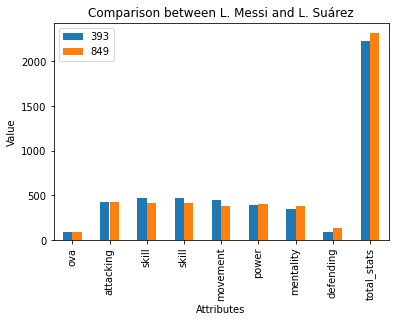

In [212]:
selected_columns = comparison.loc[['ova', 'attacking', 'skill', 'movement', 'power', 'mentality', 'defending', 'total_stats']]
selected_columns.plot(kind='bar')
plt.title('Comparison between L. Messi and L. Suárez')
plt.ylabel('Value')
plt.xlabel('Attributes')
plt.show()
#Messi is best OVA but in comparison to Suarez, suarez is a better defender and is more powerful and may know the game a little better than messi.

In [213]:
fastest_player = df1.sort_values(['sprint_speed'],ascending=[False]).head(10)

In [214]:
#fastest player Adama Traore
fastest_player

,name,age,ova,club,position,pot,height,weight,foot,value,wage,attacking,crossing,finishing,heading_accuracy,short_passing,volleys,skill,dribbling,curve,fk_accuracy,long_passing,ball_control,skill,movement,acceleration,sprint_speed,agility,reactions,balance,power,shot_power,jumping,stamina,strength,long_shots,mentality,aggression,interceptions,positioning,vision,penalties,composure,defending,marking,standing_tackle,sliding_tackle,goalkeeping,gk_diving,gk_handling,gk_kicking,gk_positioning,gk_reflexes,total_stats,gender,pac,sho,pas,dri,def,phy,hits
5331,Adama Traoré,24,79,Wolverhampton Wanderers,RW RWB,85,"5'10""",159lbs,Right,€17.5M,€80K,309,79,66,40,72,52.0,338,92,67.0,42,54,83,338,432,97,96,85.0,66,88.0,386,78,79.0,77,87,65,291,70,41.0,64.0,69.0,47,73.0,110,37,38,35.0,52,13,9,11,12,7,1918,Male,96,66,68,87,38,81,30.065505
9989,A. Chalá,24,69,Dijon FCO,LB LM,76,"5'10""",154lbs,Left,€1.3M,€6K,255,59,38,56,66,36.0,252,58,49.0,31,59,55,252,381,93,96,70.0,58,64.0,304,61,66.0,75,60,42,315,70,63.0,70.0,58.0,54,60.0,194,67,65,62.0,44,6,13,10,8,7,1745,Male,95,46,59,59,64,66,50.000000
8632,K. Mbappé,21,90,Paris Saint-Germain,ST LW RW,95,"5'10""",161lbs,Right,€105.5M,€160K,408,78,91,73,83,83.0,394,92,79.0,63,70,90,394,458,96,96,92.0,92,82.0,404,86,77.0,86,76,79,341,62,38.0,91.0,80.0,70,84.0,100,34,34,32.0,42,13,5,7,11,6,2147,Male,96,86,78,91,39,76,30.065505
9274,A. Davies,19,81,FC Bayern München,LB LM RM,89,"5'11""",159lbs,Left,€22.5M,€40K,340,73,67,64,77,59.0,333,85,67.0,44,58,79,333,438,96,96,85.0,79,82.0,364,71,77.0,79,74,63,356,77,76.0,75.0,68.0,60,74.0,233,77,77,79.0,47,11,11,6,5,14,2111,Male,96,67,69,83,76,76,30.065505
8701,D. James,22,77,Manchester United,RM LM,83,"5'7""",168lbs,Right,€12M,€81K,316,73,68,44,73,58.0,335,75,71.0,54,59,76,335,433,96,95,85.0,76,81.0,337,79,53.0,86,50,69,316,68,42.0,74.0,68.0,64,70.0,123,50,39,34.0,48,7,6,11,15,9,1908,Male,95,70,69,77,43,63,462.000000
10506,Vinícius Jr.,19,80,Real Madrid,LW,93,"5'9""",161lbs,Right,€27.5M,€95K,331,71,68,50,72,70.0,379,88,77.0,62,67,85,379,441,95,95,94.0,75,82.0,357,73,75.0,79,62,68,297,58,26.0,75.0,73.0,65,74.0,75,32,25,18.0,36,5,7,7,7,10,1916,Male,95,69,71,87,29,66,30.065505
10370,K. Diatta,21,77,Club Brugge KV,RW LW ST,85,"5'9""",152lbs,Right,€13M,€22K,326,68,71,62,69,56.0,331,83,62.0,42,66,78,331,427,92,95,91.0,72,77.0,387,75,94.0,88,60,70,301,57,48.0,68.0,69.0,59,73.0,137,55,32,50.0,52,10,8,11,11,12,1961,Male,94,70,67,81,47,68,294.000000
6542,L. Sané,24,85,FC Bayern München,LM,90,"6'0""",165lbs,Left,€51.5M,€100K,402,83,81,72,81,85.0,402,88,83.0,82,64,85,402,427,91,95,84.0,79,78.0,368,87,64.0,70,69,78,332,61,34.0,84.0,82.0,71,80.0,103,36,32,35.0,52,8,12,9,9,14,2086,Male,93,81,79,86,38,67,516.000000
4263,Kim In Seong,30,71,Ulsan Hyundai FC,LM CAM,71,"5'11""",163lbs,Right,€2.2M,€6K,301,72,65,45,68,51.0,303,70,58.0,48,63,64,303,408,93,95,88.0,67,65.0,311,66,79.0,67,59,40,253,39,22.0,72.0,54.0,66,63.0,102,40,31,31.0,44,7,6,12,12,7,1722,Male,94,60,64,70,33,58,13.000000
9501,A. Hakimi,21,83,Inter,RM,88,"5'11""",161lbs,Right,€35M,€92K,358,81,73,63,81,60.0,362,84,68.0,55,72,83,362,420,93,95,77.0,81,74.0,374,77,75.0,86,73,63,345,72,78.0,75.0,74.0,46,79.0,217,67,74,76.0,46,10,8,14,6,8,2122,Male,94,70,76,82,72,76,854.000000


In [215]:
FP= fastest_player[['name','sprint_speed']]
FP.head(5)

,name,sprint_speed
5331,Adama Traoré,96
9989,A. Chalá,96
8632,K. Mbappé,96
9274,A. Davies,96
8701,D. James,95


In [216]:
best_gk = df1.sort_values(['goalkeeping'],ascending=[False]).head(10)

In [217]:
#M.Neuer best goal keeper OVA
best_gk

,name,age,ova,club,position,pot,height,weight,foot,value,wage,attacking,crossing,finishing,heading_accuracy,short_passing,volleys,skill,dribbling,curve,fk_accuracy,long_passing,ball_control,skill,movement,acceleration,sprint_speed,agility,reactions,balance,power,shot_power,jumping,stamina,strength,long_shots,mentality,aggression,interceptions,positioning,vision,penalties,composure,defending,marking,standing_tackle,sliding_tackle,goalkeeping,gk_diving,gk_handling,gk_kicking,gk_positioning,gk_reflexes,total_stats,gender,pac,sho,pas,dri,def,phy,hits
573,M. Neuer,34,89,FC Bayern München,GK,89,"6'4""",203lbs,Right,€29M,€125K,119,15,13,25,55,11.0,160,30,14.0,11,59,46,160,286,54,60,51.0,86,35.0,284,68,77.0,43,80,16,188,29,30.0,12.0,70.0,47,70.0,38,17,10,11.0,440,87,87,91,86,89,1515,Male,87,87,91,89,57,86,222.0
2182,M. ter Stegen,28,90,FC Barcelona,GK,93,"6'2""",187lbs,Right,€69.5M,€260K,118,18,14,11,61,14.0,144,21,18.0,12,63,30,144,254,38,50,37.0,86,43.0,268,66,79.0,35,78,10,171,43,22.0,11.0,70.0,25,70.0,48,25,13,10.0,439,88,85,88,88,90,1442,Male,88,85,88,90,45,88,213.0
5112,Alisson,27,90,Liverpool,GK,91,"6'3""",201lbs,Right,€62.5M,€160K,114,17,13,19,45,20.0,138,27,19.0,18,44,30,138,268,56,47,40.0,88,37.0,240,64,52.0,32,78,14,140,27,11.0,13.0,66.0,23,65.0,50,15,19,16.0,439,86,88,85,91,89,1389,Male,86,88,85,89,51,91,228.0
3037,J. Oblak,27,91,Atlético Madrid,GK,93,"6'2""",192lbs,Right,€75M,€125K,95,13,11,15,43,13.0,109,12,13.0,14,40,30,109,307,43,60,67.0,88,49.0,268,59,78.0,41,78,12,140,34,19.0,11.0,65.0,11,68.0,57,27,12,18.0,437,87,92,78,90,90,1413,Male,87,92,78,90,52,90,220.0
4600,Ederson,26,88,Manchester City,GK,91,"6'2""",190lbs,Left,€53.5M,€195K,123,20,14,14,57,18.0,157,23,15.0,20,59,40,157,322,64,63,60.0,87,48.0,273,70,66.0,41,78,18,172,38,27.0,20.0,70.0,17,70.0,52,29,15,8.0,435,86,82,93,86,88,1534,Male,86,82,93,88,63,86,175.0
459,S. Handanovič,35,88,Inter,GK,88,"6'4""",203lbs,Right,€16M,€100K,86,12,10,10,42,12.0,100,18,12.0,14,40,16,100,272,51,55,47.0,83,36.0,264,55,78.0,41,71,19,123,25,22.0,12.0,41.0,23,69.0,48,25,10,13.0,424,88,85,73,89,89,1317,Male,88,85,73,89,53,89,82.0
933,Y. Sommer,31,86,Borussia Mönchengladbach,GK,86,"6'0""",174lbs,Right,€28.5M,€55K,84,13,13,10,40,8.0,96,15,12.0,13,31,25,96,299,48,54,55.0,84,58.0,262,64,73.0,45,68,12,162,38,21.0,15.0,64.0,24,57.0,40,9,19,12.0,423,80,86,85,87,85,1366,Male,80,86,85,85,51,87,69.0
1435,P. Gulácsi,30,85,RB Leipzig,GK,85,"6'3""",190lbs,Right,€26M,€65K,94,16,10,23,35,10.0,104,19,18.0,11,31,25,104,251,42,44,41.0,82,42.0,250,62,67.0,35,74,12,134,34,23.0,11.0,42.0,24,45.0,61,25,16,20.0,421,84,85,82,84,86,1315,Male,84,85,82,86,43,84,80.0
2137,T. Courtois,28,89,Real Madrid,GK,90,"6'6""",212lbs,Left,€56M,€250K,86,14,14,13,33,12.0,110,13,19.0,20,35,23,110,284,42,52,61.0,84,45.0,249,56,68.0,38,70,17,122,23,15.0,13.0,44.0,27,66.0,54,20,18,16.0,420,84,89,74,85,88,1325,Male,84,89,74,88,48,85,162.0
7475,A. Onana,24,84,Ajax,GK,88,"6'3""",205lbs,Right,€30M,€18K,93,15,12,20,33,13.0,143,26,30.0,17,32,38,143,331,64,62,68.0,84,53.0,279,65,80.0,39,78,17,149,32,15.0,11.0,64.0,27,61.0,44,12,18,14.0,419,84,80,87,82,86,1458,Male,84,80,87,86,63,82,278.0


In [218]:
gk= best_gk[['name','goalkeeping']]
gk.head(5)

,name,goalkeeping
573,M. Neuer,440
2182,M. ter Stegen,439
5112,Alisson,439
3037,J. Oblak,437
4600,Ederson,435


In [352]:
df1.to_csv('/Users/sarahrestrepo/Desktop/Ironhack/Python_project/df1_basic_analysis.csv')

In [219]:
#only using columns i need for BMI
df_BMI = data[['Name', 'Age','OVA','Club','Position','Height','Weight','Attacking','Skill','Movement','Power','Mentality','Defending','Total Stats','Gender']]

In [220]:
df_BMI.head()

,Name,Age,OVA,Club,Position,Height,Weight,Attacking,Skill,Movement,Power,Mentality,Defending,Total Stats,Gender
0,G. Pasquale,33,69,Udinese,LM,"6'0""",181lbs,313,338,347,347,320,208,1929,Male
1,Luis García,37,71,KAS Eupen,CM CAM CDM,"5'10""",143lbs,337,369,305,324,362,153,1906,Male
2,J. Cole,33,71,Coventry City,CAM RM RW LM,"5'9""",161lbs,337,387,295,284,317,99,1770,Male
3,D. Yorke,36,68,Sunderland,NaN,"5'11""",165lbs,264,255,176,239,271,75,1348,Male
4,Iniesta,36,81,Vissel Kobe,CM CAM,"5'7""",150lbs,367,408,346,297,370,181,2014,Male


In [221]:
df_BMI.dtypes

Name           object
Age             int64
OVA             int64
Club           object
Position       object
Height         object
Weight         object
Attacking       int64
Skill           int64
Movement        int64
Power           int64
Mentality       int64
Defending       int64
Total Stats     int64
Gender         object
dtype: object

In [222]:
#dropped from 107 to 15 columns
df_BMI.shape

(17125, 15)

In [223]:
df_BMI.describe()
#Average age of players is 25.3 with a min age of 16 and max age of 53
#Average overall players score is 66.97

,Age,OVA,Attacking,Skill,Movement,Power,Mentality,Defending,Total Stats
count,17125.000000,17125.000000,17125.000000,17125.000000,17125.000000,17125.000000,17125.000000,17125.000000,17125.000000
mean,25.272934,66.965022,258.537752,266.607591,322.693664,302.414774,261.922803,141.469898,1631.256175
std,4.942665,6.864329,72.255687,76.809344,54.933593,49.380576,62.913935,61.595180,260.357024
min,16.000000,38.000000,33.000000,43.000000,113.000000,128.000000,50.000000,17.000000,731.000000
25%,21.000000,62.000000,232.000000,232.000000,294.000000,272.000000,235.000000,84.000000,1492.000000
50%,25.000000,67.000000,271.000000,279.000000,331.000000,308.000000,269.000000,158.000000,1659.000000
75%,29.000000,72.000000,306.000000,319.000000,360.000000,339.000000,304.000000,194.000000,1812.000000
max,53.000000,93.000000,437.000000,470.000000,464.000000,444.000000,421.000000,272.000000,2316.000000


In [224]:
#standardizing column names
df_BMI.columns = [item.lower().replace(' ', '_')   for item in df_BMI.columns]

In [225]:
df_BMI.head()

,name,age,ova,club,position,height,weight,attacking,skill,movement,power,mentality,defending,total_stats,gender
0,G. Pasquale,33,69,Udinese,LM,"6'0""",181lbs,313,338,347,347,320,208,1929,Male
1,Luis García,37,71,KAS Eupen,CM CAM CDM,"5'10""",143lbs,337,369,305,324,362,153,1906,Male
2,J. Cole,33,71,Coventry City,CAM RM RW LM,"5'9""",161lbs,337,387,295,284,317,99,1770,Male
3,D. Yorke,36,68,Sunderland,NaN,"5'11""",165lbs,264,255,176,239,271,75,1348,Male
4,Iniesta,36,81,Vissel Kobe,CM CAM,"5'7""",150lbs,367,408,346,297,370,181,2014,Male


In [226]:
df_BMI.isna().sum()

name             0
age              0
ova              0
club            23
position       413
height           0
weight           0
attacking        0
skill            0
movement         0
power            0
mentality        0
defending        0
total_stats      0
gender           0
dtype: int64

In [227]:
df_BMI = df_BMI.dropna()

In [228]:
df_BMI = df_BMI.drop_duplicates()

In [229]:
df_BMI = df_BMI.reset_index(drop=True)

In [230]:
df_BMI.head(3)

,name,age,ova,club,position,height,weight,attacking,skill,movement,power,mentality,defending,total_stats,gender
0,G. Pasquale,33,69,Udinese,LM,"6'0""",181lbs,313,338,347,347,320,208,1929,Male
1,Luis García,37,71,KAS Eupen,CM CAM CDM,"5'10""",143lbs,337,369,305,324,362,153,1906,Male
2,J. Cole,33,71,Coventry City,CAM RM RW LM,"5'9""",161lbs,337,387,295,284,317,99,1770,Male


In [231]:
df_BMI.height.dtype

dtype('O')

In [232]:
df_BMI['height']

0         6'0"
1        5'10"
2         5'9"
3         5'7"
4         5'8"
         ...  
16688     6'6"
16689    5'10"
16690     5'9"
16691     5'9"
16692    5'10"
Name: height, Length: 16693, dtype: object

In [233]:
#checking how height is written
df_BMI['height'][4]

'5\'8"'

In [234]:
x = df_BMI['height'][4]

In [235]:
x.split('\'')

['5', '8"']

In [236]:
x.split('\'')[0]

'5'

In [237]:
int(x.split('\'')[0]) * 12

60

In [238]:
x.split('\'')[1]

'8"'

In [239]:
#converting string to integer
int(x.split('\'')[1].split('"')[0])

8

In [240]:
(int(x.split('\'')[0]) * 12) + (int(x.split('\'')[1].split('"')[0]))

68

In [241]:
def clean_height(x):
    return (int(x.split('\'')[0]) * 12) + (int(x.split('\'')[1].split('"')[0]))

In [242]:
list(map(clean_height, df_BMI['height']))

[72,
 70,
 69,
 67,
 68,
 67,
 70,
 70,
 67,
 71,
 69,
 74,
 66,
 70,
 69,
 74,
 73,
 76,
 69,
 71,
 75,
 71,
 71,
 70,
 76,
 73,
 69,
 71,
 69,
 78,
 75,
 69,
 73,
 71,
 72,
 73,
 75,
 72,
 77,
 70,
 67,
 70,
 70,
 69,
 71,
 68,
 72,
 73,
 71,
 67,
 73,
 72,
 75,
 72,
 70,
 72,
 76,
 69,
 68,
 70,
 74,
 70,
 70,
 69,
 71,
 70,
 70,
 67,
 74,
 71,
 72,
 73,
 71,
 72,
 71,
 70,
 72,
 73,
 74,
 71,
 72,
 71,
 76,
 72,
 75,
 78,
 73,
 76,
 73,
 71,
 72,
 75,
 69,
 70,
 74,
 74,
 74,
 65,
 76,
 72,
 74,
 72,
 67,
 73,
 72,
 74,
 72,
 72,
 72,
 70,
 68,
 69,
 70,
 74,
 69,
 70,
 72,
 68,
 70,
 74,
 75,
 77,
 74,
 72,
 70,
 70,
 69,
 70,
 72,
 73,
 69,
 70,
 71,
 70,
 76,
 72,
 77,
 72,
 72,
 72,
 72,
 77,
 72,
 75,
 73,
 71,
 72,
 73,
 74,
 74,
 67,
 71,
 68,
 79,
 75,
 70,
 78,
 74,
 69,
 73,
 75,
 74,
 74,
 76,
 70,
 76,
 76,
 66,
 72,
 69,
 69,
 69,
 78,
 75,
 72,
 76,
 68,
 71,
 74,
 74,
 71,
 74,
 69,
 67,
 70,
 74,
 69,
 75,
 69,
 71,
 76,
 74,
 72,
 72,
 77,
 77,
 72,
 72,
 72,
 75,


In [243]:
df_BMI['height_inches'] = list(map(clean_height, df_BMI['height']))

In [244]:
df_BMI.height_inches

0        72
1        70
2        69
3        67
4        68
         ..
16688    78
16689    70
16690    69
16691    69
16692    70
Name: height_inches, Length: 16693, dtype: int64

In [245]:
#drop column height as it is no longer needed
df1_clean = df_BMI.drop(['height'], axis=1)

In [246]:
df1_clean.head()

,name,age,ova,club,position,weight,attacking,skill,movement,power,mentality,defending,total_stats,gender,height_inches
0,G. Pasquale,33,69,Udinese,LM,181lbs,313,338,347,347,320,208,1929,Male,72
1,Luis García,37,71,KAS Eupen,CM CAM CDM,143lbs,337,369,305,324,362,153,1906,Male,70
2,J. Cole,33,71,Coventry City,CAM RM RW LM,161lbs,337,387,295,284,317,99,1770,Male,69
3,Iniesta,36,81,Vissel Kobe,CM CAM,150lbs,367,408,346,297,370,181,2014,Male,67
4,D. Odonkor,27,66,Alemannia Aachen,RW RM,163lbs,271,276,406,315,256,79,1649,Male,68


In [247]:
#changing column order
df1_clean = df1_clean.loc[:,['name', 'age', 'ova', 'club', 'position', 'weight','height_inches', 'attacking',
       'skill', 'movement', 'power', 'mentality', 'defending', 'total_stats',
       'gender']]

In [248]:
df1_clean.columns

Index(['name', 'age', 'ova', 'club', 'position', 'weight', 'height_inches',
       'attacking', 'skill', 'movement', 'power', 'mentality', 'defending',
       'total_stats', 'gender'],
      dtype='object')

In [249]:
df1_clean.head()

,name,age,ova,club,position,weight,height_inches,attacking,skill,movement,power,mentality,defending,total_stats,gender
0,G. Pasquale,33,69,Udinese,LM,181lbs,72,313,338,347,347,320,208,1929,Male
1,Luis García,37,71,KAS Eupen,CM CAM CDM,143lbs,70,337,369,305,324,362,153,1906,Male
2,J. Cole,33,71,Coventry City,CAM RM RW LM,161lbs,69,337,387,295,284,317,99,1770,Male
3,Iniesta,36,81,Vissel Kobe,CM CAM,150lbs,67,367,408,346,297,370,181,2014,Male
4,D. Odonkor,27,66,Alemannia Aachen,RW RM,163lbs,68,271,276,406,315,256,79,1649,Male


In [250]:
df1_clean['weight']

0        181lbs
1        143lbs
2        161lbs
3        150lbs
4        163lbs
          ...  
16688    165lbs
16689    170lbs
16690    154lbs
16691    148lbs
16692    154lbs
Name: weight, Length: 16693, dtype: object

In [251]:
df1_clean['weight'].dtype

dtype('O')

In [252]:
df1_clean['weight'][0]

'181lbs'

In [253]:
x = df1_clean['weight'][0]

In [254]:
x[:-3]

'181'

In [255]:
int(x[:-3])

181

In [256]:
#calculating BMI
int(x[:-3]) / (df1_clean['height_inches']**2) * 703

0        24.545332
1        25.967959
2        26.726108
3        28.345511
4        27.517950
           ...    
16688    20.914366
16689    25.967959
16690    26.726108
16691    26.726108
16692    25.967959
Name: height_inches, Length: 16693, dtype: float64

In [257]:
def weight(x):
    return int(x[:-3])

In [258]:
 df1_clean['new_weight'] = list(map(weight, df1_clean['weight']))

In [259]:
df1_clean['new_weight']/(df1_clean['height_inches']**2) * 703

0        24.545332
1        20.516122
2        23.772947
3        23.490755
4        24.781358
           ...    
16688    19.065582
16689    24.389796
16690    22.739340
16691    21.853392
16692    22.094286
Length: 16693, dtype: float64

In [260]:
df1_clean['bmi'] = df1_clean['new_weight']/(df1_clean['height_inches']**2) * 703

In [261]:
df1_clean.head()

,name,age,ova,club,position,weight,height_inches,attacking,skill,movement,power,mentality,defending,total_stats,gender,new_weight,bmi
0,G. Pasquale,33,69,Udinese,LM,181lbs,72,313,338,347,347,320,208,1929,Male,181,24.545332
1,Luis García,37,71,KAS Eupen,CM CAM CDM,143lbs,70,337,369,305,324,362,153,1906,Male,143,20.516122
2,J. Cole,33,71,Coventry City,CAM RM RW LM,161lbs,69,337,387,295,284,317,99,1770,Male,161,23.772947
3,Iniesta,36,81,Vissel Kobe,CM CAM,150lbs,67,367,408,346,297,370,181,2014,Male,150,23.490755
4,D. Odonkor,27,66,Alemannia Aachen,RW RM,163lbs,68,271,276,406,315,256,79,1649,Male,163,24.781358


In [262]:
df2_clean = df1_clean.drop(['weight'], axis = 1)

In [353]:
df2_clean.to_csv('/Users/sarahrestrepo/Desktop/Ironhack/Python_project/df2_clean_LM.csv')

In [263]:
df2_clean.head()

,name,age,ova,club,position,height_inches,attacking,skill,movement,power,mentality,defending,total_stats,gender,new_weight,bmi
0,G. Pasquale,33,69,Udinese,LM,72,313,338,347,347,320,208,1929,Male,181,24.545332
1,Luis García,37,71,KAS Eupen,CM CAM CDM,70,337,369,305,324,362,153,1906,Male,143,20.516122
2,J. Cole,33,71,Coventry City,CAM RM RW LM,69,337,387,295,284,317,99,1770,Male,161,23.772947
3,Iniesta,36,81,Vissel Kobe,CM CAM,67,367,408,346,297,370,181,2014,Male,150,23.490755
4,D. Odonkor,27,66,Alemannia Aachen,RW RM,68,271,276,406,315,256,79,1649,Male,163,24.781358


In [264]:
df2_clean = df1_clean.loc[:,['name', 'age', 'ova', 'club', 'position', 'bmi','height_inches','new_weight','attacking',
       'skill', 'movement', 'power', 'mentality', 'defending', 'total_stats']]

In [265]:
df2_clean.head()

,name,age,ova,club,position,bmi,height_inches,new_weight,attacking,skill,movement,power,mentality,defending,total_stats
0,G. Pasquale,33,69,Udinese,LM,24.545332,72,181,313,338,347,347,320,208,1929
1,Luis García,37,71,KAS Eupen,CM CAM CDM,20.516122,70,143,337,369,305,324,362,153,1906
2,J. Cole,33,71,Coventry City,CAM RM RW LM,23.772947,69,161,337,387,295,284,317,99,1770
3,Iniesta,36,81,Vissel Kobe,CM CAM,23.490755,67,150,367,408,346,297,370,181,2014
4,D. Odonkor,27,66,Alemannia Aachen,RW RM,24.781358,68,163,271,276,406,315,256,79,1649


In [266]:
df2_clean.dtypes

name              object
age                int64
ova                int64
club              object
position          object
bmi              float64
height_inches      int64
new_weight         int64
attacking          int64
skill              int64
movement           int64
power              int64
mentality          int64
defending          int64
total_stats        int64
dtype: object

<AxesSubplot:xlabel='bmi'>

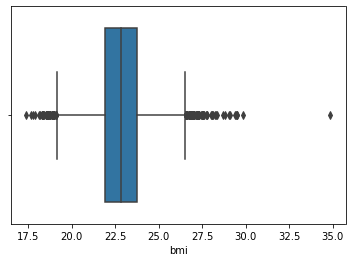

In [267]:
sns.boxplot(x = df2_clean['bmi']) #with outliers

<AxesSubplot:xlabel='bmi'>

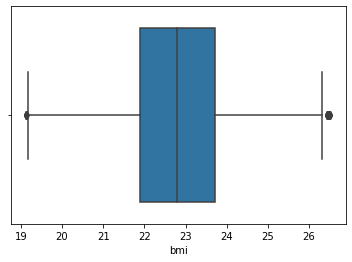

In [273]:
sns.boxplot(x = df2_clean['bmi']) #without outliers

In [268]:
xbmi = np.percentile(df2_clean['bmi'], 75)
xbmi1 = np.percentile(df2_clean['bmi'], 25)
print(xbmi)
print(xbmi1)
iqr = xbmi - xbmi1
print(iqr)
upper_limit = xbmi + 1.5*iqr
print(upper_limit)
lower_limit = xbmi1 - 1.5*iqr
print(lower_limit)

23.745777777777775
21.894663757191033
1.851114020586742
26.522448808657888
19.11799272631092


In [271]:
df2_clean = df2_clean[(df2_clean['bmi']<upper_limit) & (df2_clean['bmi']>lower_limit)]

In [272]:
df2_clean['bmi'].describe()

count    16510.000000
mean        22.818490
std          1.322598
min         19.120949
25%         21.894664
50%         22.795503
75%         23.707598
max         26.515857
Name: bmi, dtype: float64

In [274]:
def log_transform(x):
    if x > 0:
        return np.log(x)
    else:
        return np.nan

<AxesSubplot:ylabel='Density'>

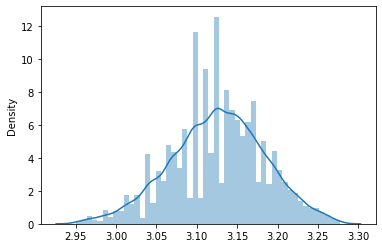

In [275]:
bmi_lt = list(map(  log_transform, df2_clean['bmi']))
sns.distplot(bmi_lt)

<AxesSubplot:xlabel='age'>

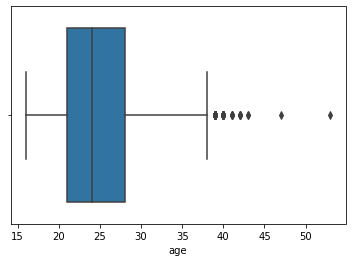

In [276]:
sns.boxplot(x = df2_clean['age']) #with outliers

<AxesSubplot:xlabel='age'>

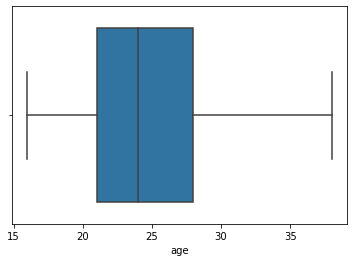

In [280]:
sns.boxplot(x = df2_clean['age']) #without outliers

In [277]:
xage = np.percentile(df2_clean['age'], 75)
xage1 = np.percentile(df2_clean['age'], 25)
print(xage)
print(xage1)
iqr = xage - xage1
print(iqr)
upper_limit = xage + 1.5*iqr
print(upper_limit)
lower_limit = xage1 - 1.5*iqr
print(lower_limit)

28.0
21.0
7.0
38.5
10.5


In [278]:
df2_clean = df2_clean[(df2_clean['age']<upper_limit) & (df2_clean['age']>lower_limit)]

In [279]:
df2_clean['age'].describe()

count    16445.000000
mean        24.994284
std          4.711124
min         16.000000
25%         21.000000
50%         24.000000
75%         28.000000
max         38.000000
Name: age, dtype: float64

In [281]:
def log_transform(x):
    if x > 0:
        return np.log(x)
    else:
        return np.nan

<AxesSubplot:ylabel='Density'>

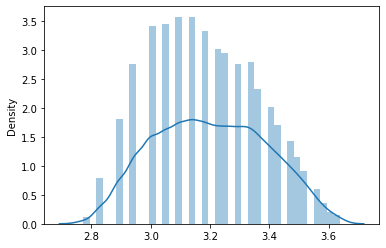

In [282]:
age_lt = list(map(log_transform, df2_clean['age']))
sns.distplot(age_lt)

<AxesSubplot:xlabel='ova'>

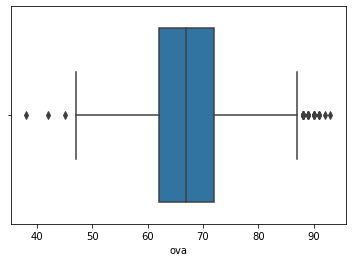

In [283]:
sns.boxplot(x = df2_clean['ova'])

<AxesSubplot:xlabel='height_inches'>

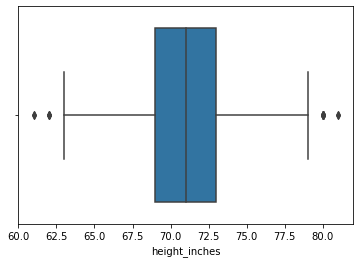

In [284]:
sns.boxplot(x = df2_clean['height_inches']) 

<AxesSubplot:xlabel='new_weight'>

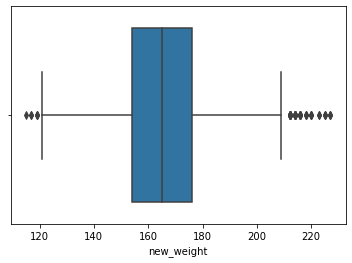

In [286]:
sns.boxplot(x = df2_clean['new_weight']) #with outliers

<AxesSubplot:xlabel='new_weight'>

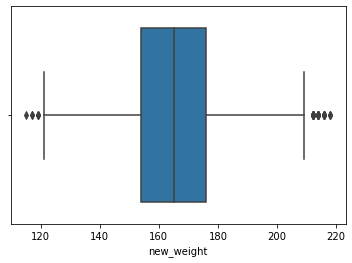

In [289]:
sns.boxplot(x = df2_clean['new_weight']) #without outliers

In [287]:
xnew_weight = np.percentile(df2_clean['new_weight'], 75)
xnew_weight1 = np.percentile(df2_clean['new_weight'], 25)
print(xnew_weight)
print(xnew_weight1)
iqr = xnew_weight - xnew_weight1
print(iqr)
upper_limit = xnew_weight + 2*iqr
print(upper_limit)
lower_limit = xnew_weight1 - 2*iqr
print(lower_limit)

176.0
154.0
22.0
220.0
110.0


In [288]:
df2_clean = df2_clean[(df2_clean['new_weight']<upper_limit) & (df2_clean['new_weight']>lower_limit)]

<AxesSubplot:xlabel='attacking'>

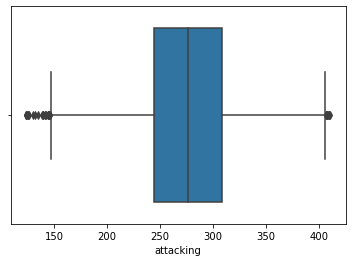

In [294]:
sns.boxplot(x = df2_clean['attacking']) #without outliers

<AxesSubplot:xlabel='attacking'>

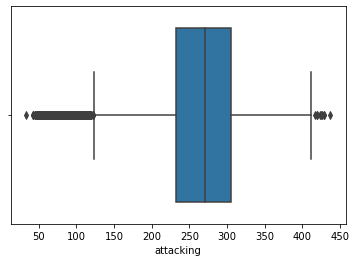

In [290]:
sns.boxplot(x = df2_clean['attacking']) #with outliers

In [291]:
xattacking = np.percentile(df2_clean['attacking'], 75)
xattacking1 = np.percentile(df2_clean['attacking'], 25)
print(xattacking)
print(xattacking1)
iqr = xattacking - xattacking1
print(iqr)
upper_limit = xattacking + 1.5*iqr
print(upper_limit)
lower_limit = xattacking1 - 1.5*iqr
print(lower_limit)

305.0
232.0
73.0
414.5
122.5


In [292]:
df2_clean = df2_clean[(df2_clean['attacking']<upper_limit) & (df2_clean['attacking']>lower_limit)]

In [293]:
df2_clean['attacking'].describe()

count    14977.000000
mean       275.928824
std         46.262761
min        123.000000
25%        244.000000
50%        276.000000
75%        309.000000
max        411.000000
Name: attacking, dtype: float64

<AxesSubplot:ylabel='Density'>

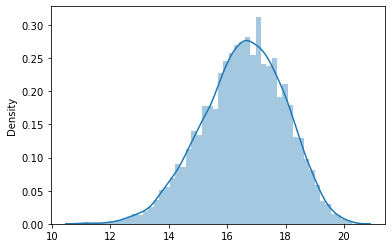

In [296]:
attack_pt = list(map(lambda x: math.sqrt(x), df2_clean['attacking']))
sns.distplot(attack_pt)

<AxesSubplot:xlabel='skill'>

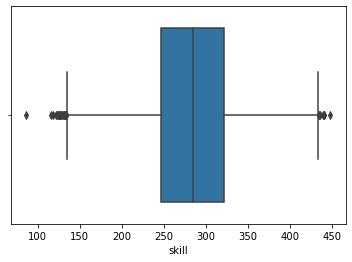

In [297]:
sns.boxplot(x = df2_clean['skill']) #with outliers

<AxesSubplot:xlabel='skill'>

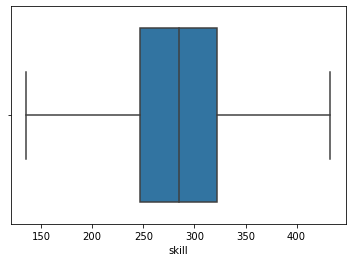

In [301]:
sns.boxplot(x = df2_clean['skill']) #without outliers

In [298]:
xskill = np.percentile(df2_clean['skill'], 75)
xskill1 = np.percentile(df2_clean['skill'], 25)
print(xskill)
print(xskill1)
iqr = xskill - xskill1
print(iqr)
upper_limit = xskill + 1.5*iqr
print(upper_limit)
lower_limit = xskill1 - 1.5*iqr
print(lower_limit)

322.0
247.0
75.0
434.5
134.5


In [299]:
df2_clean = df2_clean[(df2_clean['skill']<upper_limit) & (df2_clean['skill']>lower_limit)]

In [300]:
df2_clean['skill'].describe()

count    14943.000000
mean       284.062170
std         54.006275
min        135.000000
25%        247.000000
50%        285.000000
75%        322.000000
max        433.000000
Name: skill, dtype: float64

<AxesSubplot:ylabel='Density'>

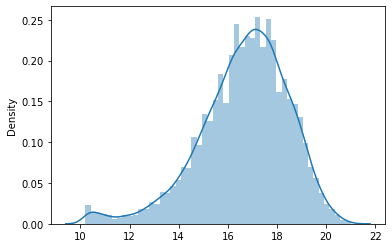

In [302]:
skill_pt = list(map(lambda x: math.sqrt(x), df2_temp_skill['skill']))
sns.distplot(skill_pt)

<AxesSubplot:xlabel='movement'>

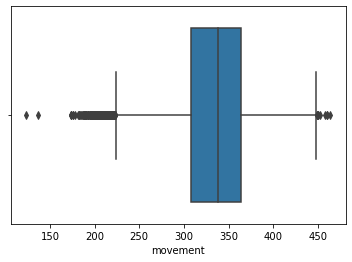

In [303]:
sns.boxplot(x = df2_clean['movement']) #with outliers

<AxesSubplot:xlabel='movement'>

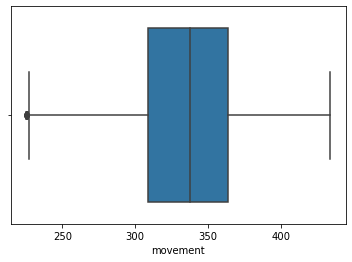

In [311]:
sns.boxplot(x = df2_clean['movement'])# without outliers

In [308]:
xmove = np.percentile(df2_clean['movement'], 75)
xmove1 = np.percentile(df2_clean['movement'], 25)
print(xmove)
print(xmove1)
iqr = xmove - xmove1
print(iqr)
upper_limit = xmove + 1.5*iqr
print(upper_limit)
lower_limit = xmove1 - 1.5*iqr
print(lower_limit)

364.0
308.0
56.0
448.0
224.0


In [309]:
df2_clean = df2_clean[(df2_clean['movement']<upper_limit) & (df2_clean['movement']>lower_limit)]

In [310]:
df2_clean['movement'].describe()

count    14641.000000
mean       335.838877
std         40.338057
min        225.000000
25%        309.000000
50%        338.000000
75%        364.000000
max        434.000000
Name: movement, dtype: float64

In [356]:
def log_transform(x):
    if x > 0:
        return np.log(x)
    else:
        return np.nan

<AxesSubplot:ylabel='Density'>

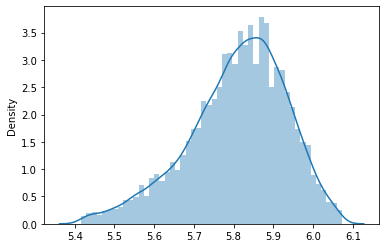

In [313]:
move_lt = list(map(log_transform, df2_clean['movement']))
sns.distplot(move_lt)

<AxesSubplot:xlabel='power'>

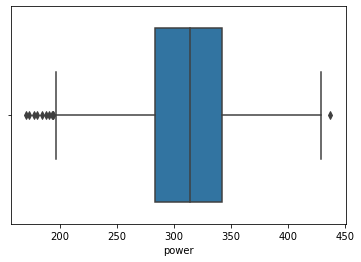

In [314]:
sns.boxplot(x = df2_clean['power'])# with outliers

<AxesSubplot:xlabel='power'>

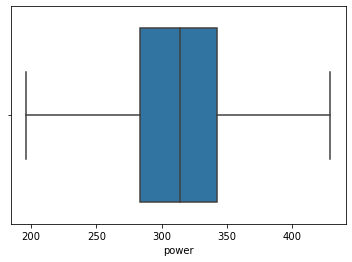

In [318]:
sns.boxplot(x = df2_clean['power'])#without outliers

In [315]:
xpower = np.percentile(df2_clean['power'], 75)
xpower1 = np.percentile(df2_clean['power'], 25)
print(xpower)
print(xpower1)
iqr = xpower - xpower1
print(iqr)
upper_limit = xpower + 1.5*iqr
print(upper_limit)
lower_limit = xpower1 - 1.5*iqr
print(lower_limit)

342.0
283.0
59.0
430.5
194.5


In [316]:
df2_clean = df2_clean[(df2_clean['power']<upper_limit) & (df2_clean['power']>lower_limit)]

In [317]:
df2_clean['power'].describe()

count    14630.000000
mean       311.931237
std         40.021598
min        196.000000
25%        283.000000
50%        314.000000
75%        342.000000
max        429.000000
Name: power, dtype: float64

In [319]:
def log_transform(x):
    if x > 0:
        return np.log(x)
    else:
        return np.nan

<AxesSubplot:ylabel='Density'>

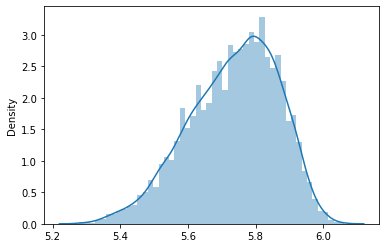

In [320]:
power_lt = list(map(log_transform, df2_clean['power']))
sns.distplot(power_lt)

<AxesSubplot:xlabel='mentality'>

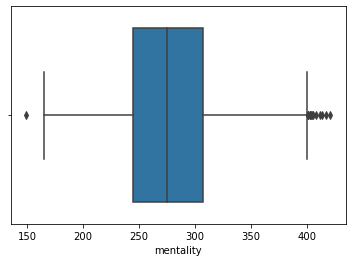

In [321]:
sns.boxplot(x = df2_clean['mentality']) #with outliers

<AxesSubplot:xlabel='mentality'>

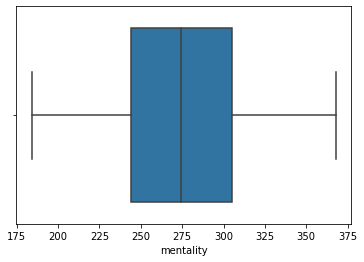

In [325]:
sns.boxplot(x = df2_clean['mentality'])#without outliers

In [322]:
xment = np.percentile(df2_clean['mentality'], 75)
xment1 = np.percentile(df2_clean['mentality'], 25)
print(xment)
print(xment1)
iqr = xment - xment1
print(iqr)
upper_limit = xment + 1.0*iqr
print(upper_limit)
lower_limit = xment1 - 1.0*iqr
print(lower_limit)

307.0
245.0
62.0
369.0
183.0


In [324]:
df2_clean = df2_clean[(df2_clean['mentality']<upper_limit) & (df2_clean['mentality']>lower_limit)]

In [326]:
def log_transform(x):
    if x > 0:
        return np.log(x)
    else:
        return np.nan

<AxesSubplot:ylabel='Density'>

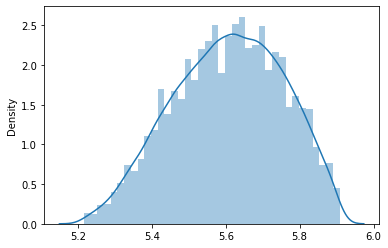

In [327]:
ment_lt = list(map(log_transform, df2_clean['mentality']))
sns.distplot(ment_lt)

<AxesSubplot:xlabel='defending'>

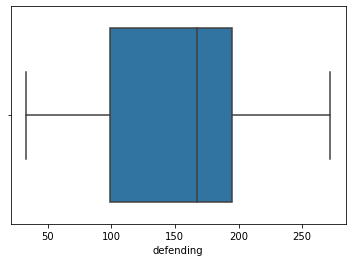

In [328]:
sns.boxplot(x = df2_clean['defending'])

<AxesSubplot:xlabel='total_stats'>

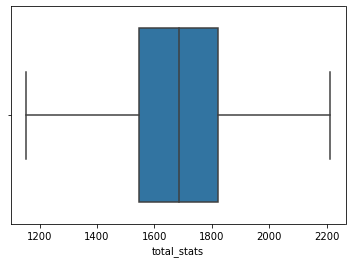

In [329]:
sns.boxplot(x = df2_clean['total_stats'])

<AxesSubplot:xlabel='total_stats'>

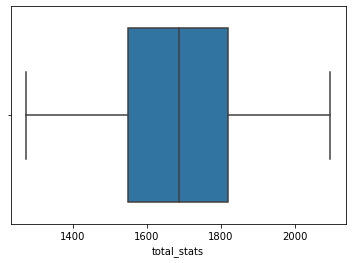

In [332]:
sns.boxplot(x = df2_clean['total_stats'])

In [330]:
xstats = np.percentile(df2_clean['total_stats'], 75)
xstats1 = np.percentile(df2_clean['total_stats'], 25)
print(xstats)
print(xstats1)
iqr = xstats - xstats1
print(iqr)
upper_limit = xstats + 1.0*iqr
print(upper_limit)
lower_limit = xstats1 - 1.0*iqr
print(lower_limit)

1822.0
1547.0
275.0
2097.0
1272.0


In [331]:
df2_clean = df2_clean[(df2_clean['total_stats']<upper_limit) & (df2_clean['total_stats']>lower_limit)]

In [333]:
def log_transform(x):
    if x > 0:
        return np.log(x)
    else:
        return np.nan

<AxesSubplot:ylabel='Density'>

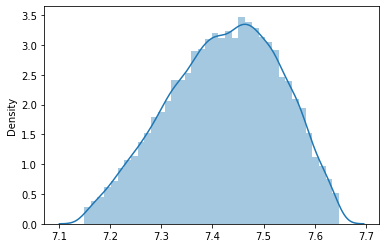

In [334]:
stats_lt = list(map(log_transform, df2_clean['total_stats']))
sns.distplot(stats_lt)

In [335]:
df2_clean = df2_clean.reset_index(drop=True)

<AxesSubplot:>

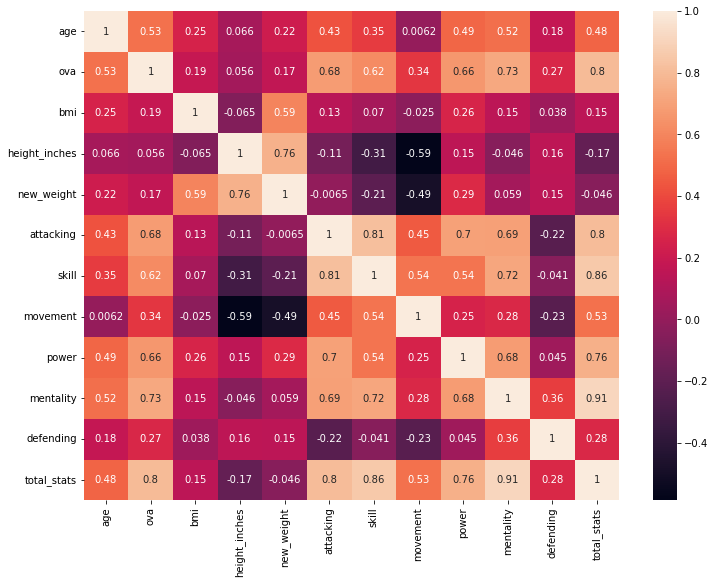

In [336]:
numericals = df2_clean.select_dtypes(np.number)
plt.figure(figsize=(12, 9))
corr_matrix = numericals.corr()
sns.heatmap(corr_matrix, annot=True)

In [338]:
categoricals = df2_clean.select_dtypes(np.object)
categoricals

,name,club,position
0,G. Pasquale,Udinese,LM
1,Luis García,KAS Eupen,CM CAM CDM
2,J. Cole,Coventry City,CAM RM RW LM
3,D. Odonkor,Alemannia Aachen,RW RM
4,G. Neville B,Manchester United,RB CB RWB
...,...,...,...
14153,R. Shanley,Hibernian,ST
14154,W. Rickard,Burnley,CAM CM
14155,C. Barrett,Burnley,RB
14156,J. Gazibegović,SK Sturm Graz,RB LB


In [339]:
df2_clean.isna().sum()

name             0
age              0
ova              0
club             0
position         0
bmi              0
height_inches    0
new_weight       0
attacking        0
skill            0
movement         0
power            0
mentality        0
defending        0
total_stats      0
dtype: int64

In [340]:
y = df2_clean['ova']
features = df2_clean.drop(['ova'], axis=1)

In [341]:
numerical_features = features.select_dtypes(np.number)
categorical_features = features.select_dtypes(np.object)

In [342]:
numerical_features.head()

,age,bmi,height_inches,new_weight,attacking,skill,movement,power,mentality,defending,total_stats
0,33,24.545332,72,181,313,338,347,347,320,208,1929
1,37,20.516122,70,143,337,369,305,324,362,153,1906
2,33,23.772947,69,161,337,387,295,284,317,99,1770
3,27,24.781358,68,163,271,276,406,315,256,79,1649
4,35,24.963673,70,174,304,258,324,284,319,242,1774


In [343]:
scaled = Normalizer().fit_transform(numerical_features)
scaled = pd.DataFrame(scaled)
scaled.head()

,0,1,2,3,4,5,6,7,8,9,10
0,0.015805,0.011756,0.034484,0.086690,0.149911,0.161884,0.166195,0.166195,0.153263,0.099621,0.923890
1,0.017922,0.009938,0.033907,0.069266,0.163236,0.178736,0.147736,0.156939,0.175345,0.074110,0.923226
2,0.017141,0.012348,0.035840,0.083626,0.175043,0.201014,0.153228,0.147514,0.164655,0.051422,0.919366
3,0.015007,0.013773,0.037794,0.090595,0.150621,0.153400,0.225653,0.175076,0.142284,0.043908,0.916508
4,0.018223,0.012997,0.036445,0.090593,0.158277,0.134327,0.168690,0.147864,0.166086,0.125997,0.923628


In [344]:
categorical_features.shape

(14158, 3)

In [345]:
categorical_features.head()

,name,club,position
0,G. Pasquale,Udinese,LM
1,Luis García,KAS Eupen,CM CAM CDM
2,J. Cole,Coventry City,CAM RM RW LM
3,D. Odonkor,Alemannia Aachen,RW RM
4,G. Neville B,Manchester United,RB CB RWB


In [346]:
pd.get_dummies(categorical_features['club'], drop_first=True)

,1. FC Kaiserslautern,1. FC Köln,1. FC Magdeburg,1. FC Nürnberg,1. FC Saarbrücken,1. FC Union Berlin,1. FSV Mainz 05,AC Ajaccio,AC Arles Avignon,AC Horsens,AC Mineros de Guayana,AC Monza,AD Alcorcón,ADO Den Haag,AEK Athens,AFC Wimbledon,AIK,AJ Auxerre,AS Monaco,AS Nancy Lorraine,AS Saint-Étienne,AZ Alkmaar,Aalborg BK,Aalesunds FK,Aarhus GF,Aberdeen,Abha Club,Academica Clinceni,Accrington Stanley,Adanaspor,Adelaide United,Ajax,Akhisar Belediyespor,Al Adalah,Al Ahli,Al Ain FC,Al Batin,Al Faisaly,Al Fateh,Al Fayha,Al Hazem,Al Hilal,Al Ittihad,Al Nassr,Al Orobah,Al Qadisiyah,Al Raed,Al Shabab,Al Taawoun,Al Wehda,Alanyaspor,Albacete BP,Albirex Niigata,Alemannia Aachen,Alianza Lima,Alianza Petrolera,Always Ready,Amiens SC,Amkar Perm,América de Cali,Angers SCO,Antalyaspor,Aragua FC,Argentina,Argentinos Juniors,Arka Gdynia,Arsenal,Arsenal Tula,Arsenal de Sarandí,Ascoli,Associação Académica de Coimbra,Aston Villa,Astra Giurgiu,Atalanta,Athletic Club de Bilbao,Atiker Konyaspor,Atlanta United,Atlante,Atlético Bucaramanga,Atlético Clube Goianiense,Atlético Huila,Atlético Madrid,Atlético Mineiro,Atlético Nacional,Atlético Tucumán,Atlético de San Luis,Audax Italiano,Australia,Austria,Avaí FC,BB Erzurumspor,BK Häcken,BSC Young Boys,Bahia,Barcelona Sporting Club,Bari,Barnet,Barnsley,Barrow,Bayer 04 Leverkusen,Bayern München II,Beerschot AC,Beijing Renhe FC,Beijing Sinobo Guoan FC,Belgium,Benevento,Beşiktaş JK,Birmingham City,Blackburn Rovers,Blackpool,Boavista FC,Boca Juniors,Bohemian FC,Bolivia,Bologna,Bolton Wanderers,Borussia Dortmund,Borussia Mönchengladbach,Botafogo,Bournemouth,Bradford City,Brazil,Brentford,Brescia,Brighton & Hove Albion,Brisbane Roar,Bristol City,Bristol Rovers,Bruk-Bet Termalica Nieciecza,Brøndby IF,Bulgaria,Burnley,Bursaspor,Burton Albion,Bury,Busan IPark,C.D. Castellón,CA Bastia,CA Osasuna,CD Antofagasta,CD Aves,CD Cobresal,CD Everton de Viña del Mar,CD Huachipato,CD Leganés,CD Lugo,CD Mirandés,CD Nacional,CD Numancia,CD O'Higgins,CD Palestino,CD Tenerife,CD Tondela,CD Universidad de Concepción,CE Sabadell FC,CF Fuenlabrada,CF Rayo Majadahonda,CFR Cluj,Cagliari,Cambridge United,Cameroon,Canada,Caracas FC,Cardiff City,Carlisle United,Castellammare di Stabia,Ceará Sporting Club,Celtic,Central Coast Mariners,Central Córdoba,Centro Atlético Fénix,Cerezo Osaka,Cesena,Chacarita Juniors,Chamois Niortais Football Club,Changchun Yatai FC,Chapecoense,Charlton Athletic,Chelsea,Cheltenham Town,Chemnitzer FC,Chicago Fire,Chievo Verona,Chile,China PR,Chindia Târgovişte,Chivas USA,Chongqing Dangdai Lifan FC SWM Team,Cittadella,Clermont Foot 63,Club América,Club Athletico Paranaense,Club Atlas,Club Atlético Aldosivi,Club Atlético Banfield,Club Atlético Colón,Club Atlético Grau,Club Atlético Huracán,Club Atlético Lanús,Club Atlético Talleres,Club Atlético Tigre,Club Blooming,Club Bolívar,Club Brugge KV,Club Guaraní,Club León,Club Libertad,Club Necaxa,Club Plaza Colonia,Club Tijuana,Clube Sport Marítimo,Colchester United,Colo-Colo,Colombia,Colorado Rapids,Columbus Crew SC,Coquimbo Unido,Corinthians,Coritiba,Cork City,Cosenza,Coventry City,Cracovia,Crawley Town,Crewe Alexandra,Criciúma,Crotone,Cruz Azul,Cruzeiro,Crystal Palace,Curicó Unido,Cusco FC,Czech Republic,Cádiz CF,Córdoba CF,Côte d'Ivoire,Cúcuta Deportivo,DC United,DSC Arminia Bielefeld,Daegu FC,Dalian YiFang FC,Damac FC,De Graafschap,Defensa y Justicia,Delfín SC,Denizlispor,Denmark,Deportes Iquique,Deportes Tolima,Deportivo Alavés,Deportivo Binacional,Deportivo Cali,Deportivo Pasto,Deportivo Toluca,Deportivo de La Coruña,Derby County,Derry City,Dijon FCO,Dinamo Bucureşti,Dinamo Zagreb,Djurgårdens IF,Doncaster Rovers,Dundalk,Dundee FC,Dundee United,Dynamo Kyiv,ESTAC Troyes,Ecuador,Egypt,Eintracht Braunschweig,Eintracht Frankfurt,El Nacional,Elche CF,Emelec,Empoli,En Avant de Guingamp,Envigado FC,Esbjerg fB,Eskişehirspor,Estoril Praia,Estudiantes de La Plata,Estudiantes de Mérida,Ettifaq FC,Everton,Excelsior,Exeter City,Extremadura UD,FC Aarau,FC Admira Wacker Mödling,FC Anzhi 

In [347]:
pd.get_dummies(categorical_features['position'], drop_first=True)

,CAM,CAM CDM,CAM CDM CM,CAM CDM LM,CAM CF,CAM CF CM,CAM CF LM,CAM CF LW,CAM CF RM,CAM CF RW,CAM CF ST,CAM CM,CAM CM CDM,CAM CM CF,CAM CM LM,CAM CM LM RM,CAM CM LW,CAM CM RM,CAM CM RW,CAM CM ST,CAM LB,CAM LB LM,CAM LM,CAM LM CF,CAM LM CM,CAM LM LB,CAM LM LW,CAM LM LWB LB,CAM LM RM,CAM LM RW,CAM LM ST,CAM LW,CAM LW CF,CAM LW CM,CAM LW LM,CAM LW RW,CAM LW RW CM,CAM LW ST,CAM RB,CAM RM,CAM RM CF,CAM RM CM,CAM RM CM ST,CAM RM LM,CAM RM LM ST,CAM RM LW,CAM RM RB,CAM RM RW,CAM RM RW LM,CAM RM ST,CAM RW,CAM RW CF,CAM RW CM,CAM RW LM,CAM RW LW,CAM RW RM,CAM RW ST,CAM RWB CM,CAM ST,CAM ST CF,CAM ST CM,CAM ST LM,CAM ST LW,CAM ST RM,CAM ST RW,CB,CB CAM,CB CDM,CB CDM CM,CB CDM LB,CB CDM RB,CB CM,CB CM CDM,CB LB,CB LB CDM,CB LB LWB,CB LB RB,CB LM,CB LWB,CB RB,CB RB CDM,CB RB CM,CB RB LB,CB RB RM,CB RB RWB,CB RB ST,CB RM RB,CB RWB,CB RWB RB,CB RWB RM,CB ST,CDM,CDM CAM,CDM CAM CM,CDM CAM LM,CDM CB,CDM CB CM,CDM CB LB,CDM CB RB,CDM CB RM,CDM CM,CDM CM CAM,CDM CM CB,CDM CM LB,CDM CM LM,CDM CM RB,CDM CM RM,CDM CM RW,CDM CM RWB,CDM LB,CDM LB CB,CDM LB CM,CDM LM,CDM LWB LB,CDM RB,CDM RB CB,CDM RB CM,CDM RB LB,CDM RB RM,CDM RM,CDM RM RB,CDM RWB,CF,CF CAM,CF CAM CM,CF CAM LM,CF CAM LW,CF CAM RW,CF CAM ST,CF CM,CF CM LM,CF LM,CF LM CAM,CF LM LW,CF LM RM,CF LW,CF LW CAM,CF LW RW,CF LW ST,CF RM,CF RM RW,CF RM ST,CF RW,CF RW LW,CF ST,CF ST CAM,CF ST CM,CF ST LM,CF ST LW,CF ST RM,CF ST RW,CF ST RW CAM,CM,CM CAM,CM CAM CDM,CM CAM CF,CM CAM LB,CM CAM LM,CM CAM LW,CM CAM RB,CM CAM RM,CM CAM RW,CM CAM RW RM,CM CAM ST,CM CB,CM CB CDM,CM CDM,CM CDM CAM,CM CDM CB,CM CDM LB,CM CDM LM,CM CDM LW,CM CDM RB,CM CDM RM,CM CDM ST,CM CF,CM CF CAM,CM CF RM,CM LB,CM LB LM,CM LM,CM LM CAM,CM LM CB,CM LM CDM,CM LM LB,CM LM LW,CM LM RM,CM LM RW,CM LM ST,CM LW,CM LW CAM,CM LW LM,CM LW ST,CM LWB,CM RB,CM RB CDM,CM RB LM,CM RB RM,CM RM,CM RM CAM,CM RM CDM,CM RM LM,CM RM LW,CM RM RB,CM RM RW,CM RM RWB,CM RW,CM RW CAM,CM RW LW,CM RW ST,CM RWB,CM ST,CM ST CDM,GK,IILB,IIRM,IVST RM CF,LB,LB CAM,LB CB,LB CB CDM,LB CB LM,LB CB LWB,LB CB RB,LB CDM,LB CDM CB,LB CDM CM CB,LB CM,LB CM LM,LB CM LW,LB CM RB,LB CM ST,LB LM,LB LM CAM,LB LM CB,LB LM CDM,LB LM CM,LB LM LW,LB LM LWB,LB LM RB,LB LM RM,LB LW,LB LW CM,LB LW LM,LB LW RW,LB LWB,LB LWB CB,LB LWB CDM,LB LWB CM,LB LWB LM,LB LWB LW,LB LWB RB,LB RB,LB RB CB,LB RB CDM,LB RB CM,LB RB LM,LB RB LWB,LB RB RM,LB RB RWB,LB RM,LM,LM CAM,LM CAM CDM,LM CAM CF,LM CAM CM,LM CAM CM CF,LM CAM LB,LM CAM LW,LM CAM RM,LM CAM ST,LM CDM,LM CF,LM CF CAM,LM CF RM,LM CF ST,LM CM,LM CM CAM,LM CM CDM,LM CM LB,LM CM RM,LM CM RW,LM LB,LM LB CDM,LM LB CF,LM LB CM,LM LB LW,LM LB LWB,LM LB RB,LM LB RM,LM LW,LM LW CAM,LM LW CF,LM LW LB,LM LW RM,LM LW RW,LM LW ST,LM LWB,LM LWB CB,LM LWB LB,LM LWB RW,LM LWB ST,LM RB LB,LM RM,LM RM CAM,LM RM CB,LM RM CF,LM RM CM,LM RM LB,LM RM LW,LM RM LWB,LM RM RB,LM RM RW,LM RM ST,LM RW,LM RW RM,LM RWB RM,LM ST,LM ST CAM,LM ST CF,LM ST CM,LM ST LB,LM ST LW,LM ST RM,LM ST RW,LW,LW CAM,LW CAM CF,LW CAM CM,LW CAM LM,LW CAM RM,LW CAM RW,LW CAM RW LM,LW CAM ST,LW CF,LW CF LM,LW CF RW,LW CF ST,LW CM,LW LB,LW LB CAM,LW LB LM,LW LM,LW LM CAM,LW LM CF,LW LM LB,LW LM RM,LW LM ST,LW LWB RWB,LW RM CF,LW RM RW,LW RW,LW RW CAM,LW RW CF,LW RW CM,LW RW LM,LW RW RM,LW RW ST,LW ST,LW ST CAM,LW ST CM,LW ST LM,LW ST RW,LWB,LWB CB,LWB CM,LWB LB,LWB LB CB,LWB LB LM,LWB LM,LWB LM CM,LWB LM LB,LWB LM LB LW,LWB LM RB,LWB LM RM,LWB LM RWB,LWB LW,LWB RWB,ND LB RB,RB,RB CB,RB CB CDM,RB CB LB,RB CB RM,RB CB RWB,RB CDM,RB CDM CM,RB CDM RM,RB CM,RB CM CAM,RB CM CB,RB CM CDM,RB CM LB,RB CM RM,RB CM RWB,RB LB,RB LB CB,RB LB CDM,RB LB RM,RB LB RWB,RB LM,RB LM LB,RB LM RM,RB LWB,RB RM,RB RM CAM,RB RM CB,RB RM CDM,RB RM CM,RB RM LB,RB RM LM,RB RM RW,RB RM RWB,RB RM ST,RB RW,RB RW LB,RB RWB,RB RWB CB,RB RWB CDM,RB RWB CM,RB RWB LB,RB RWB LWB,RB RWB RM,RB RWB RW,RB ST CB,RM,RM CAM,RM CAM CF,RM CAM CM,RM CAM LM,RM CAM RB,RM CAM RW,RM CAM ST,RM CDM,RM CF,RM CF CAM,RM CF LM,RM CF ST,RM CM,RM CM CAM,RM CM CDM,RM CM LM,RM CM RB,RM CM ST,RM LB,RM LB RB,RM LM,RM LM CAM,RM LM CAM 

In [834]:
pd.get_dummies(categorical_features['name'], drop_first=True)

,A. Abdellaoui,A. Abdennour,A. Abdi,A. Abedzadeh,A. Abeid,A. Abqar,A. Abrashi,A. Acosta,A. Acquah,A. Adam,A. Addai,A. Ademi,A. Adli,A. Adnan,A. Adomah,A. Adouyev,A. Afif,A. Agbowo,A. Aguerre,A. Aguilar,A. Aguirre,A. Ahamada,A. Ahmedhodžić,A. Aidonis,A. Ait El Hadj,A. Ajeti,A. Akbulut,A. Akinfenwa,A. Akinola,A. Akinyemi,A. Akkaynak,A. Aktaş,A. Al Dohaim,A. Al Hamdan,A. Al Hamlawi,A. Al Jamaan,A. Al Jebreen,A. Al Joui,A. Al Kassar,A. Al Khaibari,A. Al Mayoof,A. Al Obaid,A. Al Shammari,A. Al Shammary,A. Al Shamrani,A. Al Sulayhim,A. Al Yami,A. Al Yousif,A. Al Zain,A. Al Zaqan,A. Albanese,A. Albers,A. Alcáraz,A. Aldrete,A. Ale,A. Alese,A. Alfageme,A. Alfaro,A. Alfárnez,A. Ali Mohamed,A. Aliev,A. Allione,A. Almendra,A. Almici,A. Alvarado,A. Amade B,A. Amaya,A. Amoo,A. Anani,A. Anastasio,A. Andersen,A. Anderson,A. Andersson,A. Andrade,A. Androutsos,A. Andrésson,A. Annan,A. Antilef,A. Antunes,A. Aouchiche,A. Appiah,A. Appindangoye,A. Araque,A. Araujo,A. Aravena,A. Arellano,A. Aremu,A. Areola,A. Argachá,A. Arias,A. Arli,A. Armstrong,A. Arregui,A. Arroyo,A. Arshavin,A. Arslan,A. Aseri,A. Ashraf,A. Asiri,A. Assal,A. Ateef,A. Auassar,A. Awad,A. Ayala,A. Ayew,A. Azeez,A. Azhil,A. Ba,A. Ba Loua,A. Baba,A. Babacan,A. Baby,A. Badan,A. Badji,A. Badri,A. Bah,A. Bajic,A. Bajrovic,A. Bakasetas,A. Bakayoko,A. Baker,A. Bakhat,A. Bakir,A. Balanta,A. Balaruban,A. Balboa,A. Baldi,A. Baldursson,A. Balić,A. Balzano,A. Bamba,A. Bamba B,A. Bani,A. Baptiste,A. Barberis,A. Barboza,A. Bareiro,A. Barillà,A. Barison,A. Barkok,A. Barlow,A. Barman,A. Barnes,A. Baroan,A. Baroja,A. Barrada,A. Barreal,A. Barreca,A. Barry,A. Barton,A. Barylla,A. Barzagli,A. Barák,A. Basit,A. Bass,A. Bassi,A. Bastiaans,A. Bastoni,A. Batalla,A. Bates,A. Batisse,A. Baumjohann,A. Bayındır,A. Beck,A. Becker,A. Bedoya,A. Beestin,A. Beghetto,A. Begović,A. Behich,A. Beiranvand,A. Beka Beka,A. Belhadji,A. Bell,A. Bella-Kotchap,A. Bellinghausen,A. Belotti,A. Benali,A. Benchaib,A. Benedetti,A. Benedyczak,A. Bennett,A. Benítez,A. Bernabei,A. Bernede,A. Bertolacci,A. Berzel,A. Besedin,A. Bifulco,A. Binous,A. Bittroff,A. Bjelland,A. Björnström,A. Blake,A. Blejdea,A. Blin,A. Bobichon,A. Bodart,A. Bodzek,A. Bolger,A. Boljević,A. Bone,A. Bongiovanni,A. Bonnet,A. Bono,A. Borkovic,A. Boroughbridge,A. Boruc,A. Boryachuk,A. Borysiuk,A. Bosetti,A. Bouchalakis,A. Boupendza,A. Boutoutaou,A. Bouzat,A. Bradley,A. Bredahl,A. Briançon,A. Brignoli,A. Briseño,A. Broja,A. Browne,A. BruusB,A. Budimbu,A. Budimir,A. Buksa,A. Bunjaku,A. Buongiorno,A. Burcă,A. Burgstaller,A. Busti,A. Buziuc,A. Byrne,A. Büttner,A. Büyük,A. Bălută,A. Cabeza,A. Cabral,A. Caceres,A. Caci,A. Cadavid,A. Cairns,A. Calabresi,A. Calcan,A. Calisir,A. Callens,A. Camargo,A. Campbell,A. Campos,A. Canbaz,A. Candela,A. Candreva,A. Canelo,A. Cannon,A. Canobbio,A. Capello,A. Carboni,A. Cardozo,A. Carleton,A. Carlone,A. Carrasquilla,A. Carrillo,A. Carroll,A. Casar,A. Cassano,A. Castro,A. Castro-Montes,A. Catellani,A. Ceesay,A. Cerci,A. Cerri,A. Cervantes,A. Chahechouhe,A. Chakraborty,A. Chalá,A. Chapman,A. Chatzigiovanis,A. Chedjou,A. Cheshire,A. Chicaiza,A. Chindriș,A. Christensen,A. Christiansen,A. Chukwu,A. Chumacero,A. Chávez,A. Ciciretti,A. Cicâldău,A. Ciobanu,A. Ciranni,A. Cirkovic,A. Cisco,A. Ciss,A. Cissokho,A. Cistana,A. Claude-Maurice,A. Clayton,A. Cochrane,A. Colassin,A. Cole,A. Collin,A. Collins,A. Colorado,A. Colpani,A. Connolly,A. Consigli,A. Conti,A. Contreras,A. Cook,A. Coote,A. Cordea,A. Cornelius,A. Correa,A. Corryn,A. Corzo B,A. Costa,A. Cougo,A. Cragno,A. Crawford,A. Cresswell,A. Crețu,A. Crognale,A. Cruz,A. Cubas,A. Curruhinca,A. Czerwiński,A. D'Alberto,A. D'Egidio,A. Da Cruz,A. Dabo,A. Dallas,A. Daniels,A. Danjuma Groeneveld,A. Dante,A. Danzi,A. Davies,A. De Bruyn,A. De John,A. De Sart,A. DeLaGarza,A. Dedić,A. Deiola,A. Dej,A. Del Piero,A. Delamea,A. Delap,A. Delort,A. Deneumostier,A. Denny,A. Descotte,A. Deshpande,A. Desjardins,A. Desmas,A. Deuro,A. Di María,A. Di Nardo,A. Di Natale,A. Dia,A. Dia Ndiaye,A. Diaby,A. Diakhaby,A. D

In [835]:
encoded = pd.get_dummies(categorical_features , drop_first=True)
encoded

,name_A. Abdellaoui,name_A. Abdennour,name_A. Abdi,name_A. Abedzadeh,name_A. Abeid,name_A. Abqar,name_A. Abrashi,name_A. Acosta,name_A. Acquah,name_A. Adam,name_A. Addai,name_A. Ademi,name_A. Adli,name_A. Adnan,name_A. Adomah,name_A. Adouyev,name_A. Afif,name_A. Agbowo,name_A. Aguerre,name_A. Aguilar,name_A. Aguirre,name_A. Ahamada,name_A. Ahmedhodžić,name_A. Aidonis,name_A. Ait El Hadj,name_A. Ajeti,name_A. Akbulut,name_A. Akinfenwa,name_A. Akinola,name_A. Akinyemi,name_A. Akkaynak,name_A. Aktaş,name_A. Al Dohaim,name_A. Al Hamdan,name_A. Al Hamlawi,name_A. Al Jamaan,name_A. Al Jebreen,name_A. Al Joui,name_A. Al Kassar,name_A. Al Khaibari,name_A. Al Mayoof,name_A. Al Obaid,name_A. Al Shammari,name_A. Al Shammary,name_A. Al Shamrani,name_A. Al Sulayhim,name_A. Al Yami,name_A. Al Yousif,name_A. Al Zain,name_A. Al Zaqan,name_A. Albanese,name_A. Albers,name_A. Alcáraz,name_A. Aldrete,name_A. Ale,name_A. Alese,name_A. Alfageme,name_A. Alfaro,name_A. Alfárnez,name_A. Ali Mohamed,name_A. Aliev,name_A. Allione,name_A. Almendra,name_A. Almici,name_A. Alvarado,name_A. Amade B,name_A. Amaya,name_A. Amoo,name_A. Anani,name_A. Anastasio,name_A. Andersen,name_A. Anderson,name_A. Andersson,name_A. Andrade,name_A. Androutsos,name_A. Andrésson,name_A. Annan,name_A. Antilef,name_A. Antunes,name_A. Aouchiche,name_A. Appiah,name_A. Appindangoye,name_A. Araque,name_A. Araujo,name_A. Aravena,name_A. Arellano,name_A. Aremu,name_A. Areola,name_A. Argachá,name_A. Arias,name_A. Arli,name_A. Armstrong,name_A. Arregui,name_A. Arroyo,name_A. Arshavin,name_A. Arslan,name_A. Aseri,name_A. Ashraf,name_A. Asiri,name_A. Assal,name_A. Ateef,name_A. Auassar,name_A. Awad,name_A. Ayala,name_A. Ayew,name_A. Azeez,name_A. Azhil,name_A. Ba,name_A. Ba Loua,name_A. Baba,name_A. Babacan,name_A. Baby,name_A. Badan,name_A. Badji,name_A. Badri,name_A. Bah,name_A. Bajic,name_A. Bajrovic,name_A. Bakasetas,name_A. Bakayoko,name_A. Baker,name_A. Bakhat,name_A. Bakir,name_A. Balanta,name_A. Balaruban,name_A. Balboa,name_A. Baldi,name_A. Baldursson,name_A. Balić,name_A. Balzano,name_A. Bamba,name_A. Bamba B,name_A. Bani,name_A. Baptiste,name_A. Barberis,name_A. Barboza,name_A. Bareiro,name_A. Barillà,name_A. Barison,name_A. Barkok,name_A. Barlow,name_A. Barman,name_A. Barnes,name_A. Baroan,name_A. Baroja,name_A. Barrada,name_A. Barreal,name_A. Barreca,name_A. Barry,name_A. Barton,name_A. Barylla,name_A. Barzagli,name_A. Barák,name_A. Basit,name_A. Bass,name_A. Bassi,name_A. Bastiaans,name_A. Bastoni,name_A. Batalla,name_A. Bates,name_A. Batisse,name_A. Baumjohann,name_A. Bayındır,name_A. Beck,name_A. Becker,name_A. Bedoya,name_A. Beestin,name_A. Beghetto,name_A. Begović,name_A. Behich,name_A. Beiranvand,name_A. Beka Beka,name_A. Belhadji,name_A. Bell,name_A. Bella-Kotchap,name_A. Bellinghausen,name_A. Belotti,name_A. Benali,name_A. Benchaib,name_A. Benedetti,name_A. Benedyczak,name_A. Bennett,name_A. Benítez,name_A. Bernabei,name_A. Bernede,name_A. Bertolacci,name_A. Berzel,name_A. Besedin,name_A. Bifulco,name_A. Binous,name_A. Bittroff,name_A. Bjelland,name_A. Björnström,name_A. Blake,name_A. Blejdea,name_A. Blin,name_A. Bobichon,name_A. Bodart,name_A. Bodzek,name_A. Bolger,name_A. Boljević,name_A. Bone,name_A. Bongiovanni,name_A. Bonnet,name_A. Bono,name_A. Borkovic,name_A. Boroughbridge,name_A. Boruc,name_A. Boryachuk,name_A. Borysiuk,name_A. Bosetti,name_A. Bouchalakis,name_A. Boupendza,name_A. Boutoutaou,name_A. Bouzat,name_A. Bradley,name_A. Bredahl,name_A. Briançon,name_A. Brignoli,name_A. Briseño,name_A. Broja,name_A. Browne,name_A. BruusB,name_A. Budimbu,name_A. Budimir,name_A. Buksa,name_A. Bunjaku,name_A. Buongiorno,name_A. Burcă,name_A. Burgstaller,name_A. Busti,name_A. Buziuc,name_A. Byrne,name_A. Büttner,name_A. Büyük,name_A. Bălută,name_A. Cabeza,name_A. Cabral,name_A. Caceres,name_A. Caci,name_A. Cadavid,name_A. Cairns,name_A. Calabresi,name_A. Calcan,name_A. Calisir,name_A. Callens,name_A. Camargo,name_A. Campbell,name_A. Campos,name_A. Canbaz,name_A. Candela,n

In [836]:
encoded = OneHotEncoder().fit_transform(categorical_features).toarray()
encoded = pd.DataFrame(encoded)
encoded

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,611,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,629,630,631,632,633,634,635,636,637,638,639,640,641,642,643,644,645,646,647,648,649,650,651,652,653,654,655,656,657,658,659,660,661,662,663,664,665,666,667,668,669,670,671,672,673,674,675,676,677,678,679,680,681,682,683,684,685,686,687,688,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,711,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,808,809,810,811,812,813,814,815,816,817,818,819,820,821,822,823,824,825,826,827,828,829,830,831,832,833,834,835,836,837,838,839,840,841,842,843,844,845,846,847,848,849,850,851,852,853,854,855,856,857,858,859,860,861,862,863,864,865,866,867,868,869,870,871,872,873,874,875,876,877,878,879,880,881,882,883,884,885,886,887,888,889,890,891,892,893,894,895,896,897,898,899,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999,1000,1001,1002,1003,1004,1005,1006,1007,1008,1009,1010,1011,1012,1013,1014,1015,1016,1017,1018,1019,1020,1021

In [837]:
features_consolidated = pd.concat([scaled, encoded], axis = 1)
features_consolidated.head()

,0,1,2,3,4,5,6,7,8,9,10,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,611,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,629,630,631,632,633,634,635,636,637,638,639,640,641,642,643,644,645,646,647,648,649,650,651,652,653,654,655,656,657,658,659,660,661,662,663,664,665,666,667,668,669,670,671,672,673,674,675,676,677,678,679,680,681,682,683,684,685,686,687,688,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,711,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,808,809,810,811,812,813,814,815,816,817,818,819,820,821,822,823,824,825,826,827,828,829,830,831,832,833,834,835,836,837,838,839,840,841,842,843,844,845,846,847,848,849,850,851,852,853,854,855,856,857,858,859,860,861,862,863,864,865,866,867,868,869,870,871,872,873,874,875,876,877,878,879,880,881,882,883,884,885,886,887,888,889,890,891,892,893,894,895,896,897,898,899,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999,1000,1001,1002,1003,1004,1005,1006,1007,1008,1009,1010,1011,1012,1013,1014,1015,1016,1

In [795]:
features_consolidated.shape

(16693, 17328)

In [796]:
x_train, x_test, y_train, y_test = train_test_split(features_consolidated, y, test_size=0.3, random_state=1)

In [797]:
x_train.shape

(11685, 17328)

In [798]:
y_train.shape

(11685,)

In [799]:
x_test.shape

(5008, 17328)

In [800]:
y_test.shape

(5008,)

In [801]:
lm = LinearRegression().fit(x_train, y_train)

In [803]:
lm.score(x_test, y_test)

-0.4657818802398348

In [806]:
predictions = lm.predict(x_test)

In [807]:
predictions

array([45.8616529 , 76.10814338, 74.23444669, ..., 83.28226861,
       69.97489829, 63.41876587])

In [808]:
errors = y_test - lm.predict(x_test)
errors

15464     2.138347
2940     -5.108143
16516    -6.234447
6061     13.977552
12077     4.531442
           ...    
6482      3.625161
13452     7.402098
8564    -17.282269
1122      1.025102
13712    -4.418766
Name: ova, Length: 5008, dtype: float64

In [809]:
mean_squared_error(y_test, lm.predict(x_test))

67.86359308145592

In [811]:
N = len(y_test)
rmse_test = np.sqrt(np.sum((np.array(y_test).flatten() - np.array(predictions).flatten())**2)/N)

In [812]:
rmse_test

8.23793621494218

In [813]:
def mae(y_test, predictions):
    y_test, predictions = np.array(y_test), np.array(predictions)
    return np.mean(np.abs(y_test - predictions))

In [815]:
print(mae(y_test, predictions))

6.243268901449385


In [816]:
predictions = lm.predict(x_test)

In [817]:
mse = mean_squared_error(y_test, predictions)

In [818]:
math.sqrt(mse)

8.23793621494218